# DUSP1 Analysis and Visualization Notebook

This notebook demonstrates how to use the new analysis manager code from `Analysis_DUSP1.py`.

In this notebook, we will:
1. Load the processed CSV files (spots, clusters, and cell properties).
2. Instantiate the measurement manager (DUSP1Measurement) and compute cell-level metrics,
   with optional SNR filtering.
3. Create a DisplayManager instance to visualize gating overlays and cell crops.
4. (Optional) Use the new expression grouping and visualization functions.

Make sure that `Analysis_DUSP1.py` is in the same directory or on the Python path.

In [1]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import dask.array as da
import os
import sys
import logging
import seaborn as sns
import datetime

# Today's date
today = datetime.date.today()
# Format date as 'Mar21' (for example)
date_str = today.strftime("%b%d")

logging.getLogger('matplotlib.font_manager').disabled = True
numba_logger = logging.getLogger('numba')
numba_logger.setLevel(logging.WARNING)

matplotlib_logger = logging.getLogger('matplotlib')
matplotlib_logger.setLevel(logging.WARNING)

src_path = os.path.abspath(os.path.join(os.getcwd(), '..', '..'))
print(src_path)
sys.path.append(src_path)

from src.Analysis_DUSP1_v2 import DUSP1AnalysisManager, SNRAnalysis, DUSP1Measurement, DUSP1DisplayManager, DUSP1_filtering

/Users/ericron/Desktop/AngelFISH


# Use the log file to search for analyses

In [2]:
loc = None
log_location = r'/Volumes/share/Users/Eric/GR_DUSP1_reruns'

In [3]:
# Load in csv files
filtered_cell_level_results = pd.read_csv('/Users/ericron/Desktop/AngelFISH/Publications/Ron_2024/dataframes/TS_R1_cell_level_results_Apr09_filtered.csv')
filtered_spots = pd.read_csv('/Users/ericron/Desktop/AngelFISH/Publications/Ron_2024/dataframes/DUSP1_D_merged_spots_Apr09_filtered.csv')
removed_spots = pd.read_csv('/Users/ericron/Desktop/AngelFISH/Publications/Ron_2024/dataframes/DUSP1_D_merged_spots_Apr09_removed.csv')
filtered_clusters = pd.read_csv('/Users/ericron/Desktop/AngelFISH/Publications/Ron_2024/dataframes/DUSP1_D_merged_clusters_Apr09_filtered.csv')
filtered_cellprops = pd.read_csv('/Users/ericron/Desktop/AngelFISH/Publications/Ron_2024/dataframes/DUSP1_D_merged_cellprops_Apr09_filtered.csv')

In [4]:
filtered_cell_level_results.keys()

Index(['Unnamed: 0', 'unique_cell_id', 'touching_border', 'MG_count',
       'nuc_MG_count', 'cyto_MG_count', 'num_ts', 'num_foci', 'num_spots_foci',
       'num_spots_ts', 'largest_ts', 'second_largest_ts', 'nuc_area_px',
       'cyto_area_px', 'avg_nuc_int', 'avg_cyto_int', 'avg_cell_int',
       'std_cell_int', 'time', 'dex_conc', 'replica', 'fov', 'nas_location',
       'h5_idx'],
      dtype='object')

Reference (control) data sample:
      Unnamed: 0  unique_cell_id  touching_border  MG_count  nuc_MG_count  \
1231        1834            1834            False       171            43   
1232        1836            1836            False        69            18   
1233        1837            1837            False       162            47   
1234        1838            1838            False       128            34   
1235        1839            1839            False        53            13   

      cyto_MG_count  num_ts  num_foci  num_spots_foci  num_spots_ts  ...  \
1231            128       0         0               0             0  ...   
1232             51       0         0               0             0  ...   
1233            115       0         0               0             0  ...   
1234             94       0         1               4             0  ...   
1235             40       0         1              36             0  ...   

      avg_nuc_int  avg_cyto_int  avg_cell_int  

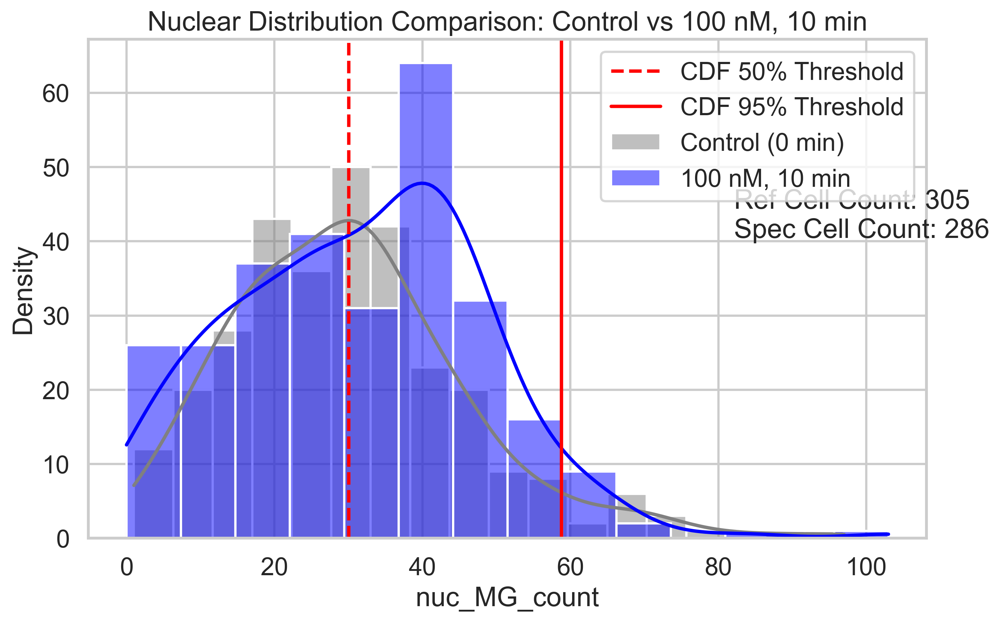

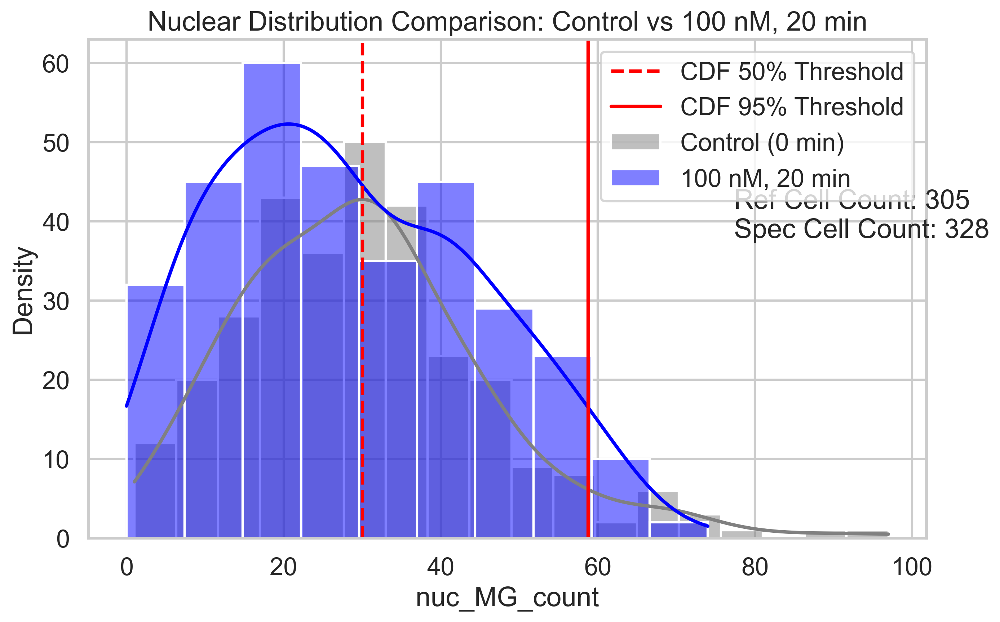

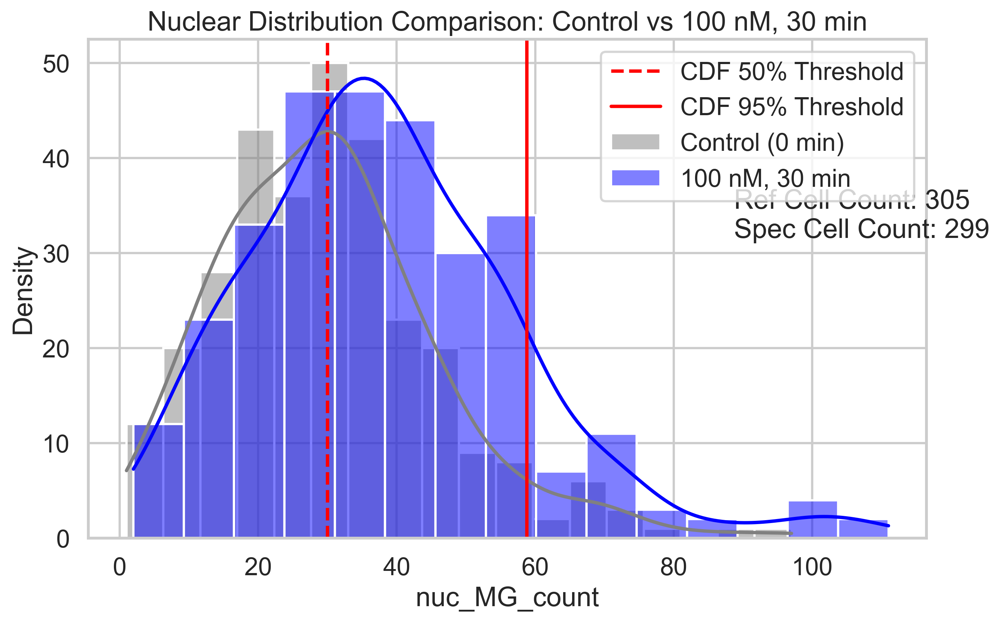

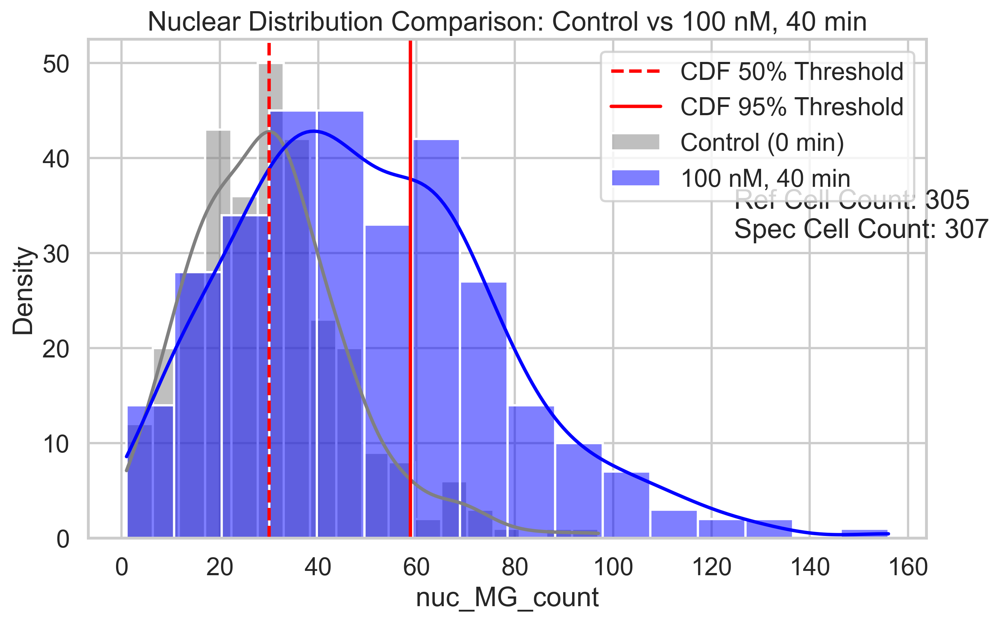

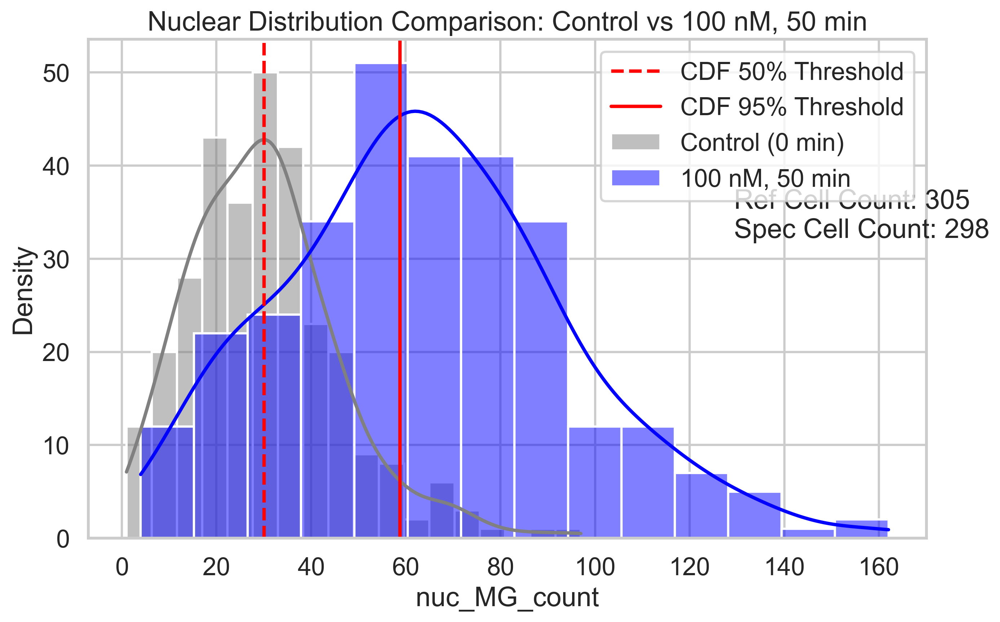

...

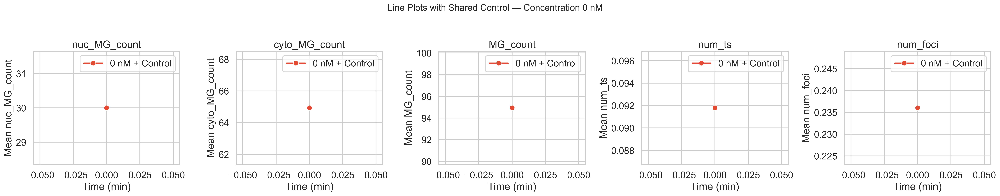

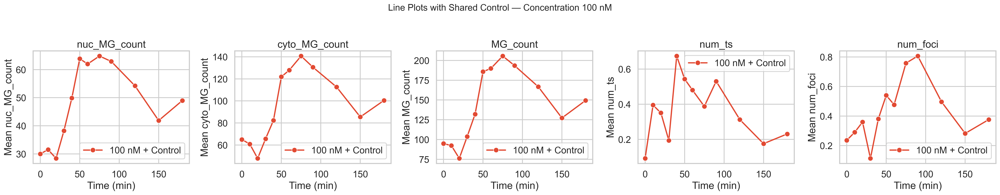

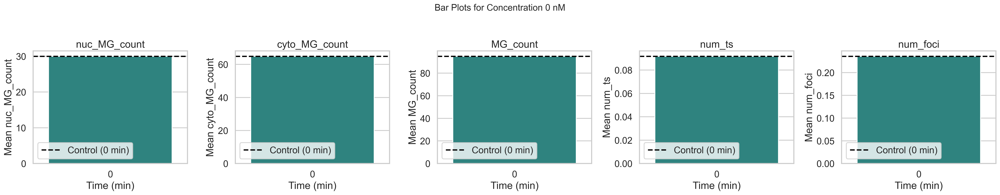

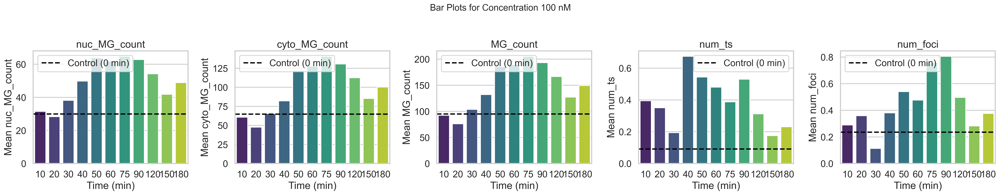

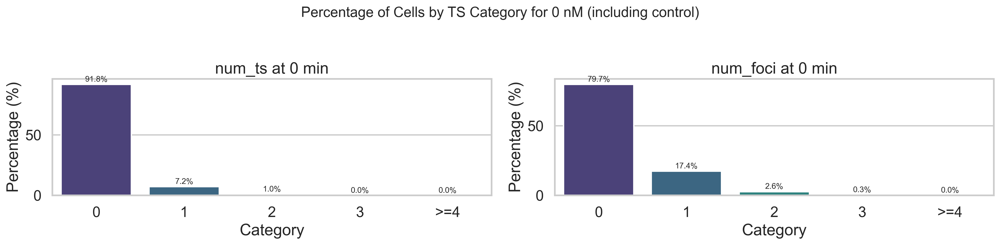

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

# ============================================================================
# Settings and Data
# ============================================================================
metrics = ['nuc_MG_count', 'cyto_MG_count', 'MG_count', 'num_ts', 'num_foci']

# Sorted unique values for concentrations and time
concentrations = sorted(filtered_cell_level_results['dex_conc'].unique())
timepoints = sorted(filtered_cell_level_results['time'].unique())

# Set common aesthetics
sns.set_context('talk')
sns.set_style('whitegrid')

# Make a copy of the main dataframe
df = filtered_cell_level_results.copy()

# ============================================================================
# Get the control (baseline) data: all rows with time == 0.
# ============================================================================
reference_data = df[df['time'] == 0]
print("Reference (control) data sample:")
print(reference_data.head())

# For the histograms below, we also calculate CDF thresholds based on one metric.
# (In this example, we use 'nuc_MG_count'; update as needed for other metrics.)
cdf_values = np.sort(reference_data['nuc_MG_count'])
cdf = np.arange(1, len(cdf_values) + 1) / len(cdf_values)
cdf_50_threshold = np.interp(0.50, cdf, cdf_values)
cdf_95_threshold = np.interp(0.95, cdf, cdf_values)

# Define the concentrations and desired timepoints for the histograms (e.g., concentration 100 only)
concentrations_to_plot = [100]  # modify as needed
desired_timepoints = [10, 20, 30, 40, 50, 60, 75, 90, 120, 150, 180]


# ============================================================================
# 1. HISTOGRAMS
# For each desired timepoint and concentration, compare the histogram for the 
# experimental condition (given dex_conc and time) with the control (time==0) data.
# ============================================================================
for time in desired_timepoints:
    for dex_conc in concentrations_to_plot:
        plt.figure(figsize=(10, 6))
        specific_data = df[(df['dex_conc'] == dex_conc) & (df['time'] == time)]
        
        sns.histplot(reference_data['nuc_MG_count'], color='grey', label='Control (0 min)', kde=True)
        sns.histplot(specific_data['nuc_MG_count'], color='blue', label=f'{dex_conc} nM, {time} min', kde=True)
        
        plt.axvline(cdf_50_threshold, color='red', linestyle='--', label='CDF 50% Threshold')
        plt.axvline(cdf_95_threshold, color='red', linestyle='-',  label='CDF 95% Threshold')
        
        plt.annotate(f'Ref Cell Count: {len(reference_data)}\nSpec Cell Count: {len(specific_data)}',
                     xy=(0.77, 0.70), xycoords='axes fraction', verticalalignment='top')
        plt.title(f'Nuclear Distribution Comparison: Control vs {dex_conc} nM, {time} min')
        plt.xlabel('nuc_MG_count')
        plt.ylabel('Density')
        plt.legend()
        plt.show()


# ============================================================================
# 2. LINE PLOTS (with control overlay)
# For each concentration, plot the mean metric value over time
# and overlay a horizontal dashed line indicating the control (0 min) mean.
# ============================================================================
for conc in concentrations:
    fig, axes = plt.subplots(1, len(metrics), figsize=(5 * len(metrics), 5))
    fig.suptitle(f'Line Plots with Shared Control — Concentration {conc} nM', fontsize=16)

    # Experimental data for this concentration
    data_conc = df[df['dex_conc'] == conc]

    # Control data (baseline): dex_conc == 0 and time == 0
    control_data = df[(df['dex_conc'] == 0) & (df['time'] == 0)]

    for i, metric in enumerate(metrics):
        ax = axes[i]

        # Experimental mean metric over time
        grouped_exp = data_conc.groupby('time')[metric].mean().reset_index()

        # Add baseline mean as the 0 min point
        if not control_data.empty:
            control_mean = control_data[metric].mean()
            # Create a new row at time=0
            control_point = pd.DataFrame({'time': [0], metric: [control_mean]})
            # Concatenate with experimental data
            combined = pd.concat([control_point, grouped_exp], ignore_index=True)
        else:
            combined = grouped_exp.copy()

        sns.lineplot(data=combined, x='time', y=metric, marker='o', ax=ax, label=f'{conc} nM + Control')

        ax.set_title(metric)
        ax.set_xlabel('Time (min)')
        ax.set_ylabel(f'Mean {metric}')
        ax.legend()

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


# ============================================================================
# 3. BAR PLOTS (with control overlay)
# For each concentration, plot a bar chart displaying the mean metric value at each timepoint
# and overlay a horizontal dashed line indicating the control (0 min) mean.
# ============================================================================
for conc in concentrations:
    fig, axes = plt.subplots(1, len(metrics), figsize=(5 * len(metrics), 5))
    fig.suptitle(f'Bar Plots for Concentration {conc} nM', fontsize=16)
    
    # Data for this concentration
    data_conc = df[df['dex_conc'] == conc]
    
    for i, metric in enumerate(metrics):
        ax = axes[i]
        df_grouped = data_conc.groupby('time')[metric].mean().reset_index()
        sns.barplot(data=df_grouped, x='time', y=metric, ax=ax, palette='viridis')
        
        # Compute control mean from reference
        control_mean = reference_data[metric].mean()
        ax.axhline(control_mean, color='black', linestyle='--', label='Control (0 min)')
        
        ax.set_title(metric)
        ax.set_xlabel('Time (min)')
        ax.set_ylabel(f'Mean {metric}')
        ax.legend()
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


# ============================================================================
# 4. CATEGORY-BASED BAR PLOTS FOR 'num_ts' and 'num_foci'
# For each concentration, display for each timepoint the fraction (percentage) of cells 
# falling into the categories "0", "1", "2", "3", or ">=4".
# Now baseline (control) data is included by concatenating the control data.
# ============================================================================
def cat_func(x):
    if x == 1:
        return '1'
    elif x == 2:
        return '2'
    elif x == 3:
        return '3'
    elif x >= 4:
        return '>=4'
    else:
        return '0'

cat_metrics = ['num_ts', 'num_foci']

for conc in concentrations:
    data_conc = df[df['dex_conc'] == conc]
    control_data = df[(df['time'] == 0) & (df['dex_conc'] == 0)]
    data_for_plot = pd.concat([control_data, data_conc], ignore_index=True)
    time_points = sorted(data_for_plot['time'].unique())

    fig, axes = plt.subplots(len(time_points), len(cat_metrics), 
                             figsize=(8 * len(cat_metrics), 4 * len(time_points)))

    # ---- MAKE AXES ALWAYS 2D ----
    if len(time_points) == 1 and len(cat_metrics) == 1:
        axes = np.array([[axes]])
    elif len(time_points) == 1:
        axes = np.expand_dims(axes, axis=0)
    elif len(cat_metrics) == 1:
        axes = np.expand_dims(axes, axis=1)
    # -----------------------------

    fig.suptitle(f'Percentage of Cells by TS Category for {conc} nM (including control)', fontsize=16)

    for row, t in enumerate(time_points):
        for col, metric in enumerate(cat_metrics):
            ax = axes[row][col]
            subset = data_for_plot[data_for_plot['time'] == t].copy()
            subset['category'] = subset[metric].apply(cat_func)

            counts = subset['category'].value_counts(normalize=True).sort_index() * 100
            categories = ['0', '1', '2', '3', '>=4']
            counts = counts.reindex(categories, fill_value=0)

            sns.barplot(x=counts.index, y=counts.values, ax=ax, palette='viridis')
            ax.set_title(f'{metric} at {t} min')
            ax.set_xlabel('Category')
            ax.set_ylabel('Percentage (%)')

            for i, v in enumerate(counts.values):
                ax.text(i, v + 1, f"{v:.1f}%", ha='center', va='bottom', fontsize=9)

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

In [6]:
# filtered_cell_level_results.head()
# filtered_clusters.keys()
# filtered_cellprops.keys()
filtered_spots.keys()

Index(['Unnamed: 0', 'z_px', 'y_px', 'x_px', 'is_nuc', 'cluster_index',
       'cell_label', 'snr', 'signal', 'fov', 'FISH_Channel', 'condition',
       'replica', 'time', 'Dex_Conc', 'NAS_location', 'h5_idx',
       'unique_spot_id', 'unique_cell_id', 'cell_intensity_mean-0',
       'cell_intensity_std-0', 'nuc_intensity_mean-0', 'nuc_intensity_std-0',
       'cyto_intensity_mean-0', 'cyto_intensity_std-0', 'MG_SNR'],
      dtype='object')

Running display_gating_overlay...
Selected H5 Index: 6
Nas Location: smFISH_images/Eric_smFISH_images/20220225/DUSP1_Dex_30min_20220224/DUSP1_Dex_30min_20220224.h5
FOV: 9
Spots DataFrame: (887, 26)
Cell Properties DataFrame: (9, 71)
Clusters DataFrame: (1, 26)


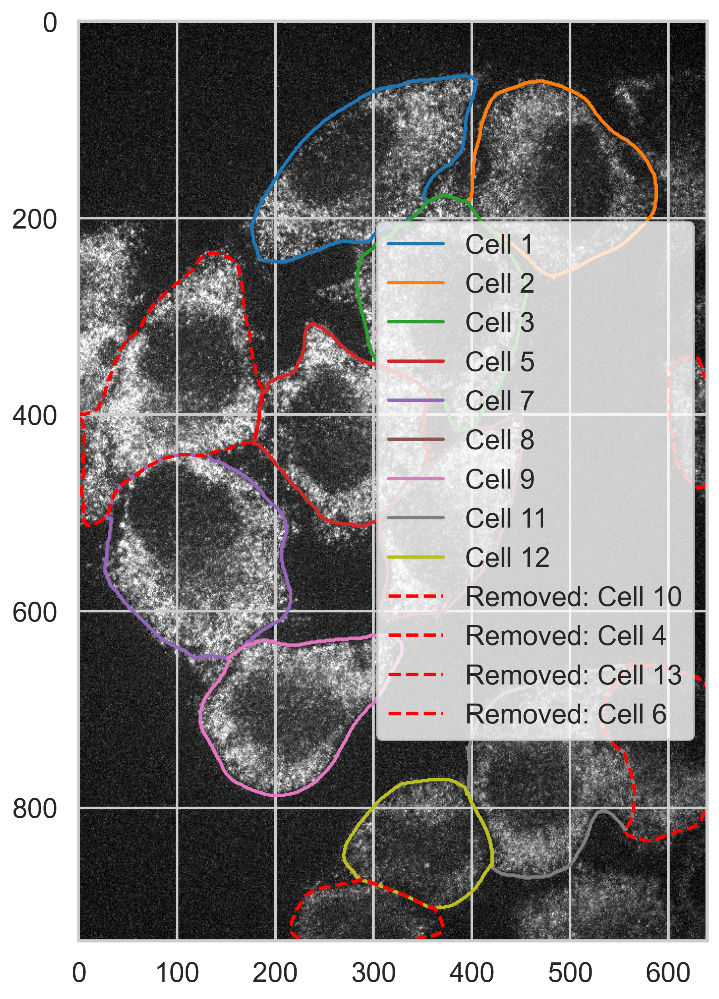

Running _display_zoom_on_cell...
Chose unique_cell_id=2883.0 with TS and Spot (FOV=9).
No Foci in this cell


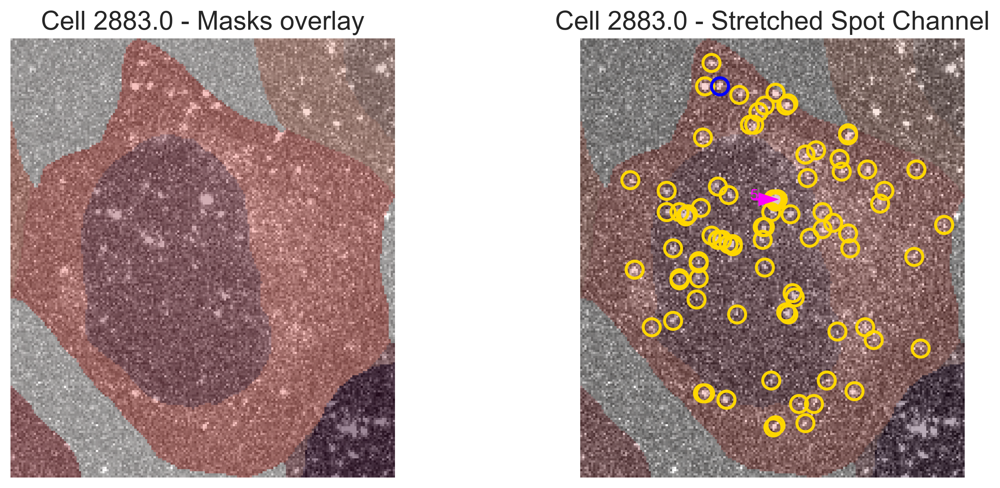

Running _display_zoom_on_one_spot...


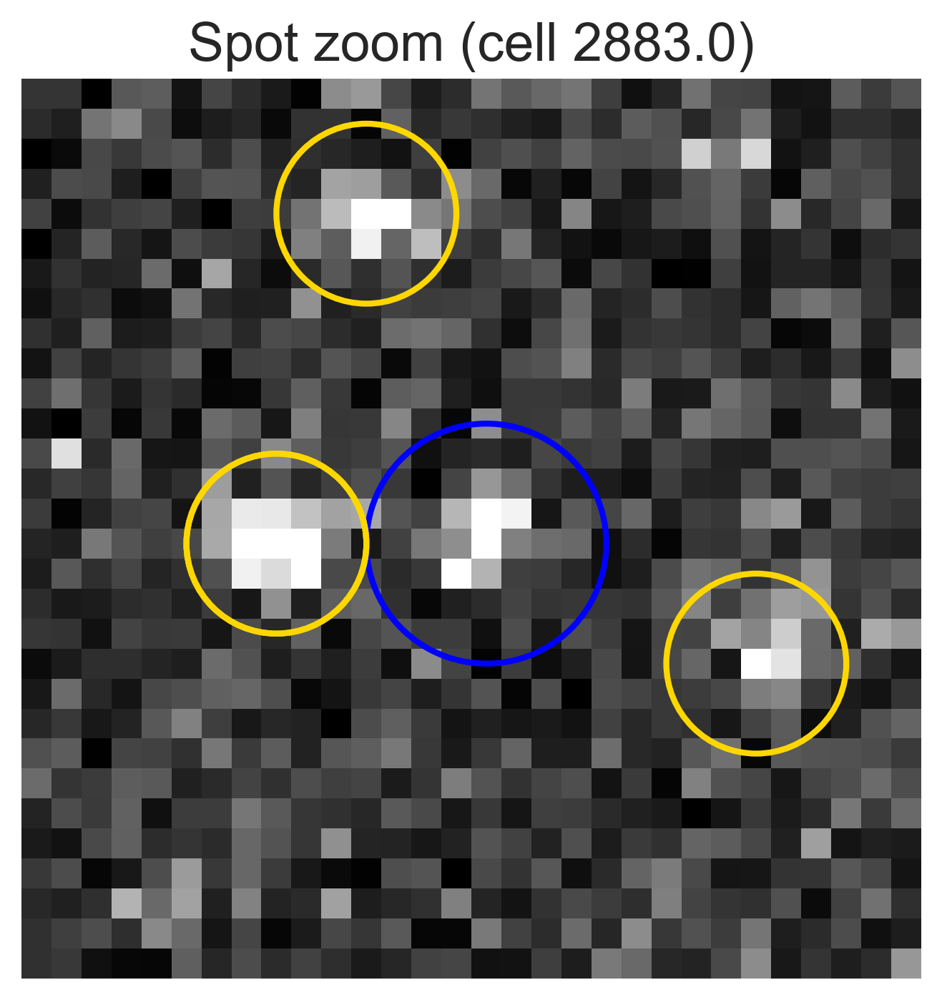

Running display_representative_cells...

Processing h5_idx 0
  Selected cell with removal 'High' from h5_idx 0.
    Displaying cell plot: NA_90_FOV28_ID386
Chose unique_cell_id=389.0 with TS, Foci, and Spot (FOV=28).


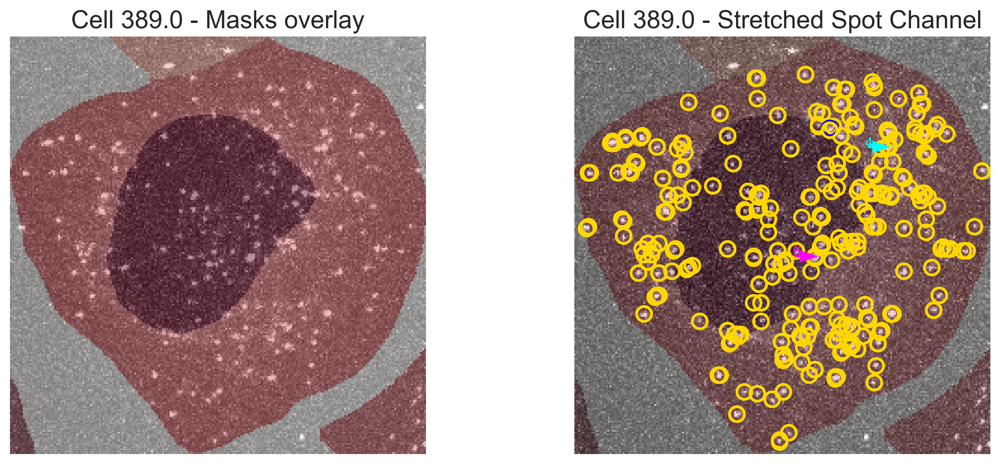

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 386.


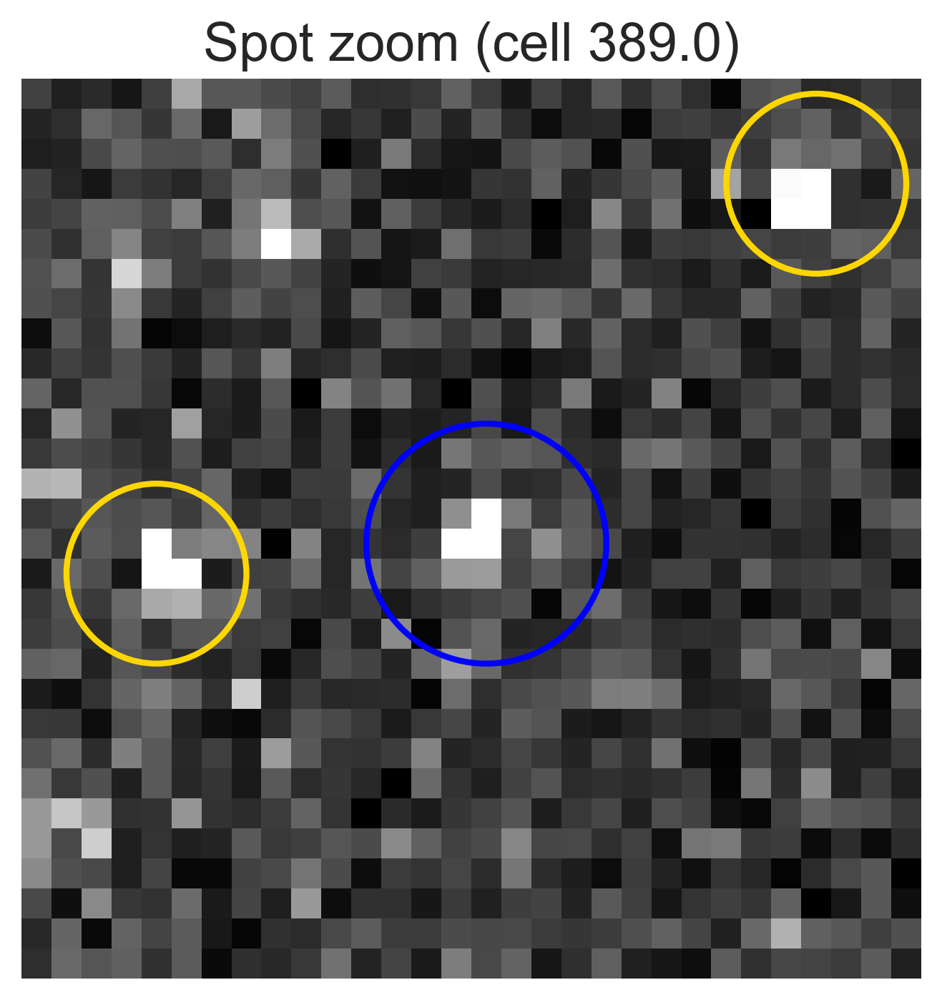

  Selected cell with removal 'Medium' from h5_idx 0.
    Displaying cell plot: NA_90_FOV18_ID239
Chose unique_cell_id=246.0 with TS, Foci, and Spot (FOV=18).


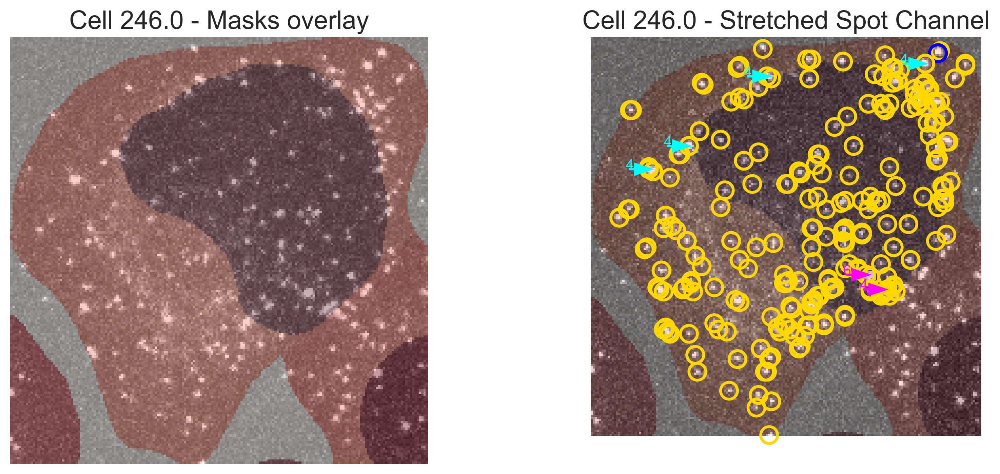

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 239.


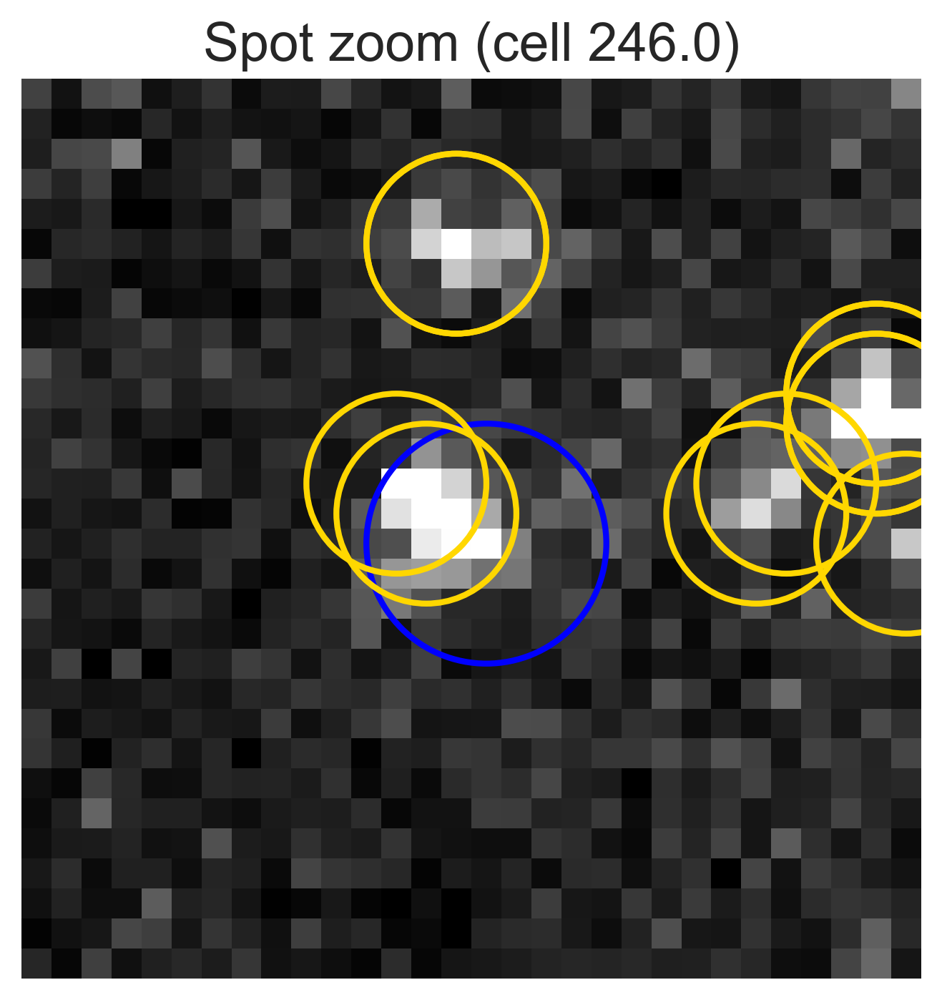

  Selected cell with removal 'Low' from h5_idx 0.
    Displaying cell plot: NA_90_FOV29_ID406
Chose unique_cell_id=400.0 with TS, Foci, and Spot (FOV=29).


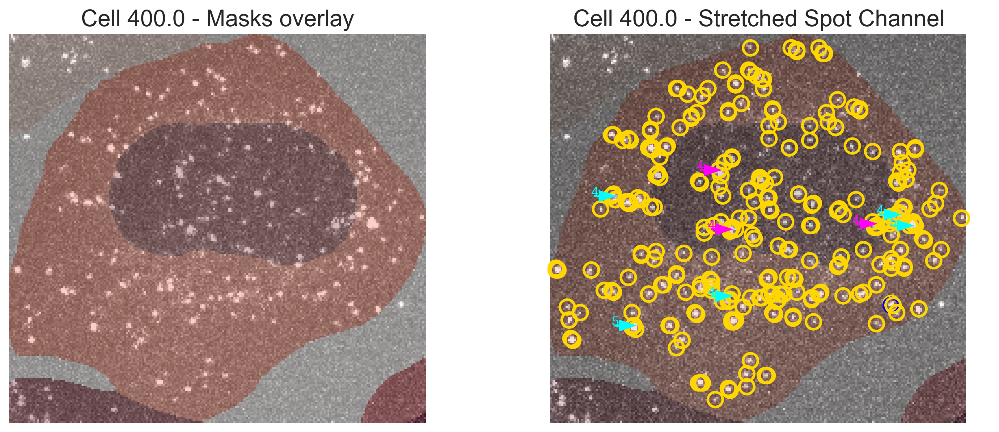

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 406.


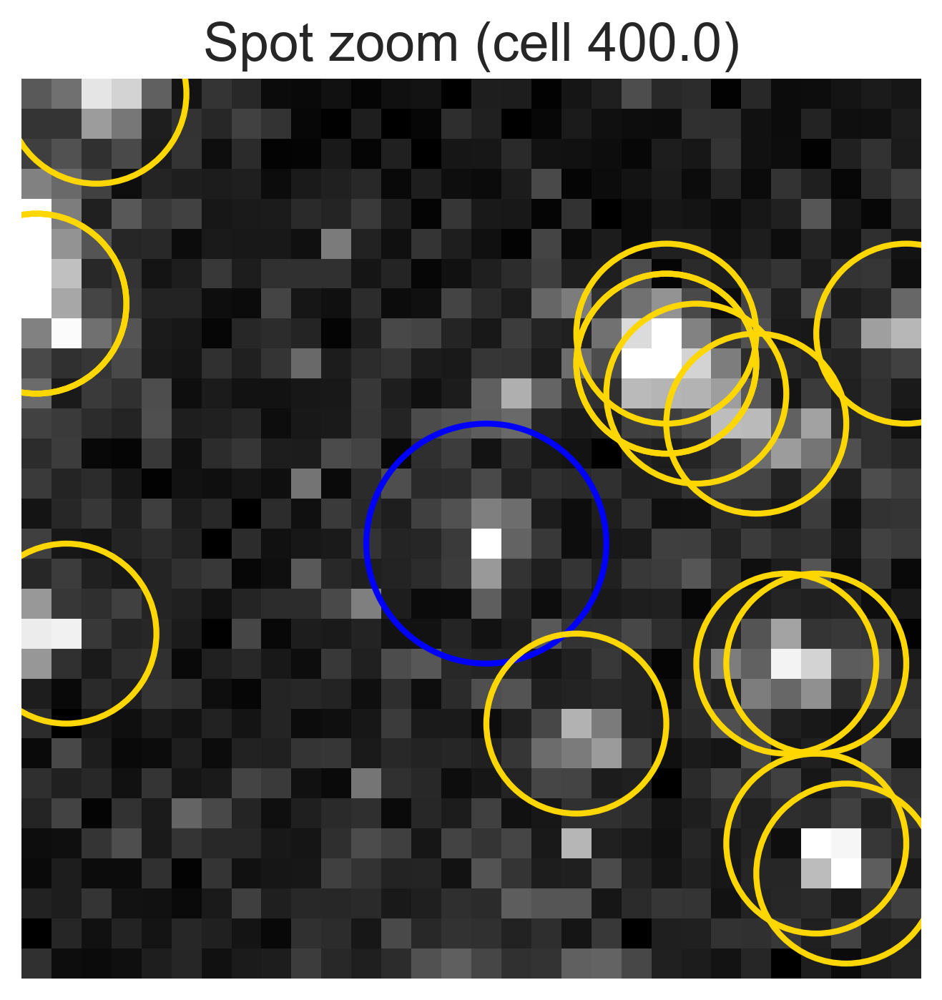


Processing h5_idx 1
  Selected cell with removal 'High' from h5_idx 1.
    Displaying cell plot: NA_120_FOV22_ID751
Chose unique_cell_id=764.0 with TS and Spot (FOV=22).
No Foci in this cell


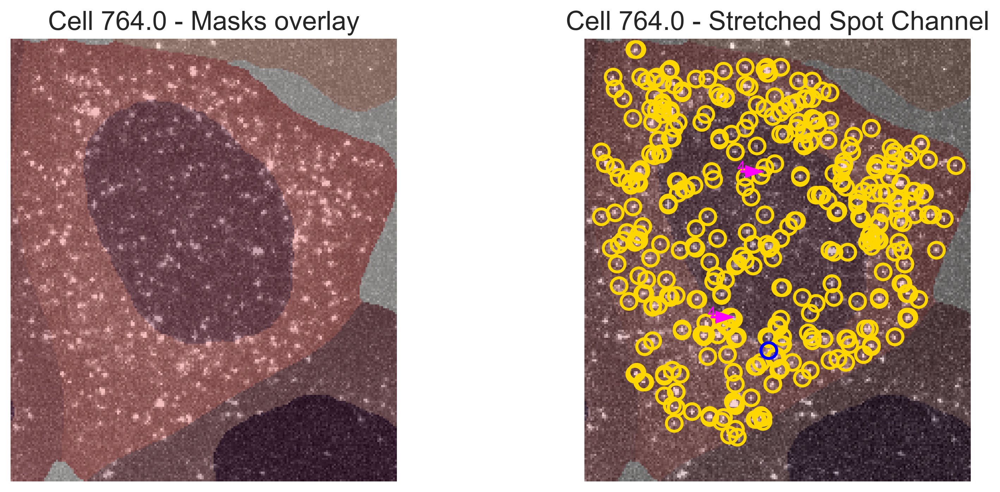

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 751.


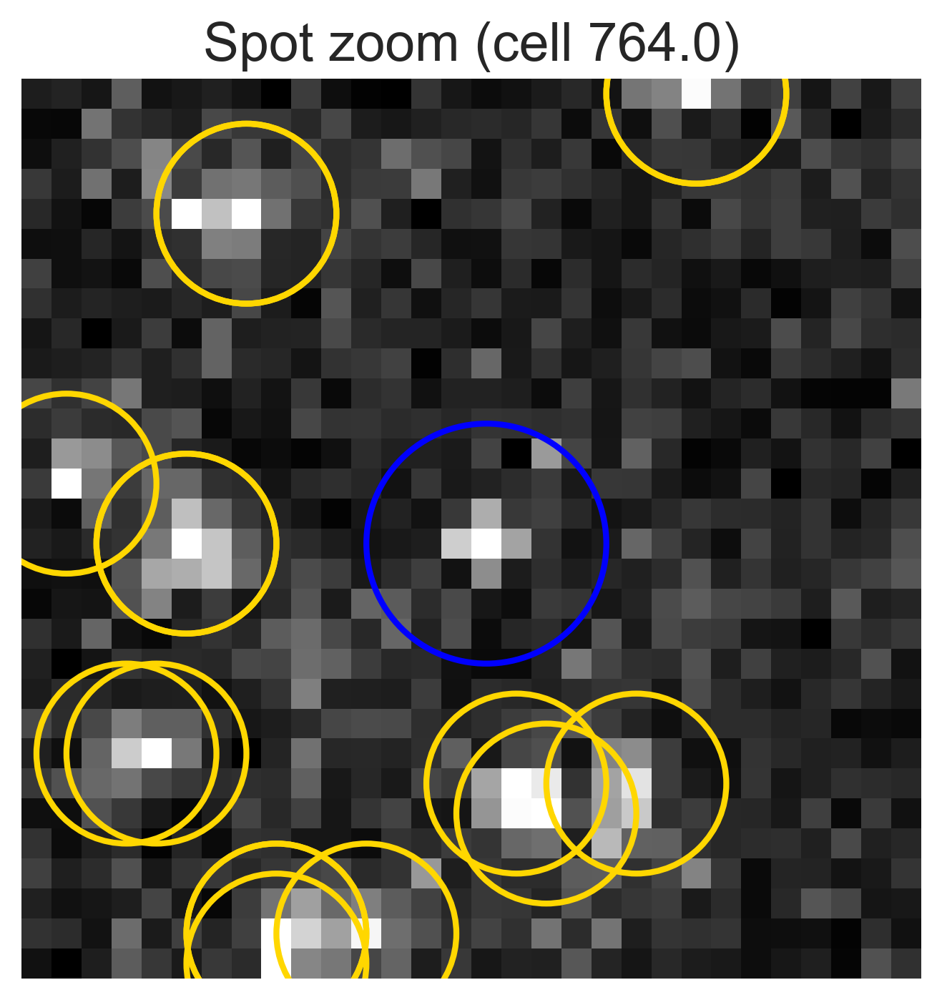

  Selected cell with removal 'Medium' from h5_idx 1.
    Displaying cell plot: NA_120_FOV20_ID720
Chose unique_cell_id=721.0 with TS, Foci, and Spot (FOV=20).


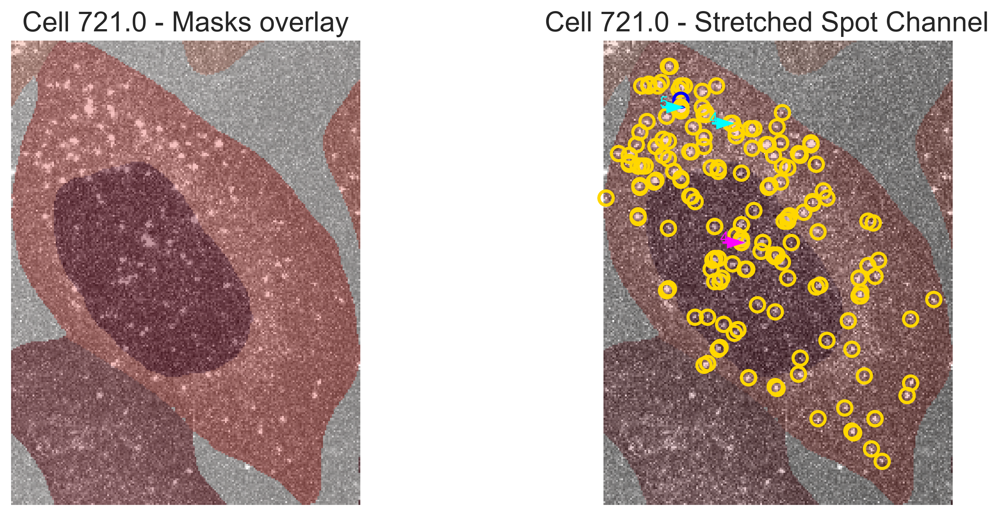

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 720.


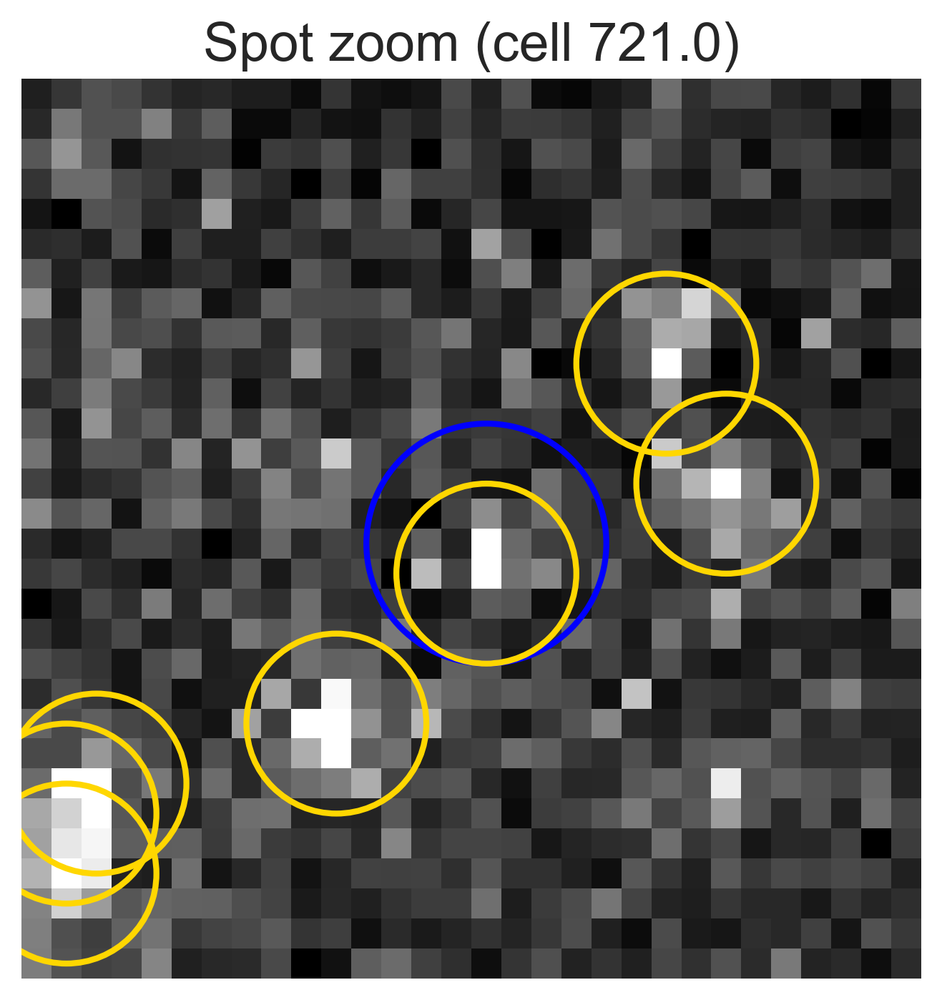

  Selected cell with removal 'Low' from h5_idx 1.
    Displaying cell plot: NA_120_FOV12_ID600
Chose unique_cell_id=602.0 with TS, Foci, and Spot (FOV=12).


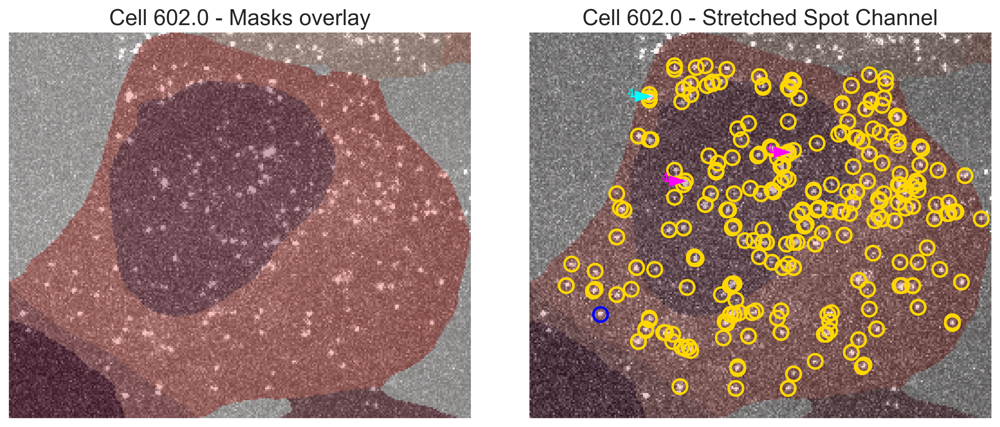

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 600.


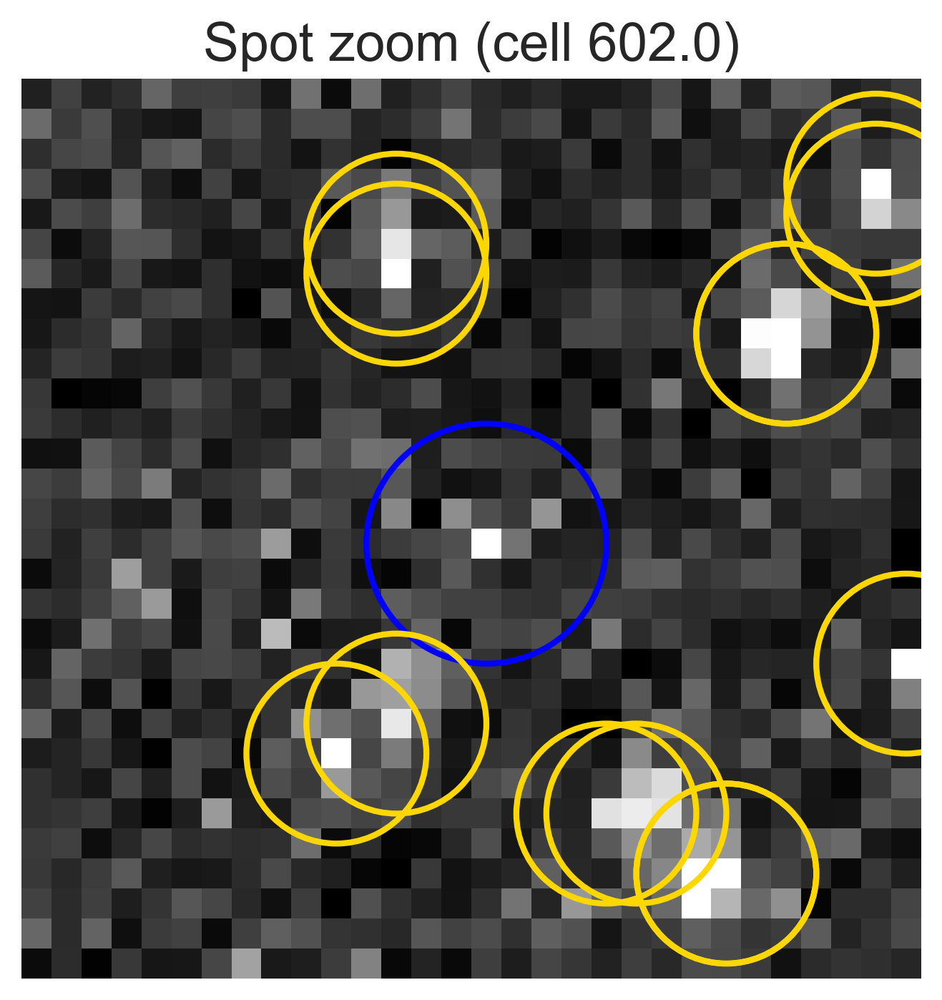


Processing h5_idx 2
  Selected cell with removal 'High' from h5_idx 2.
    Displaying cell plot: NA_150_FOV2_ID946
Chose unique_cell_id=940.0 with TS and Spot (FOV=2).
No Foci in this cell


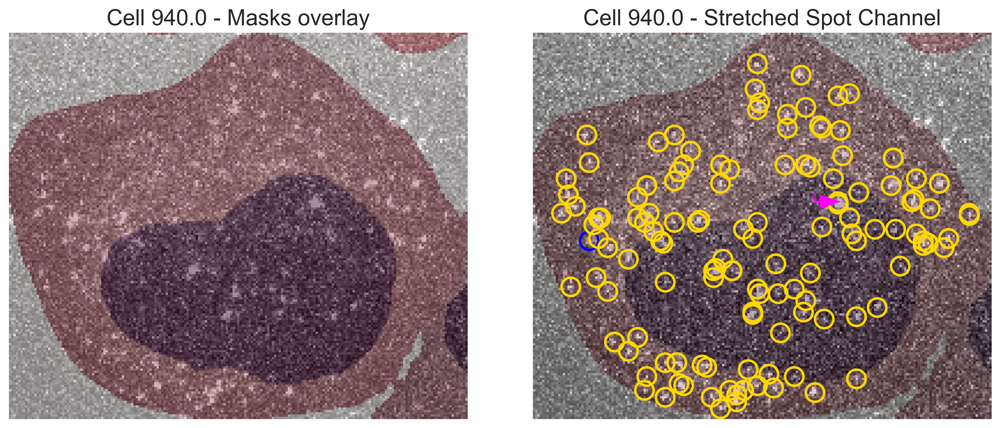

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 946.


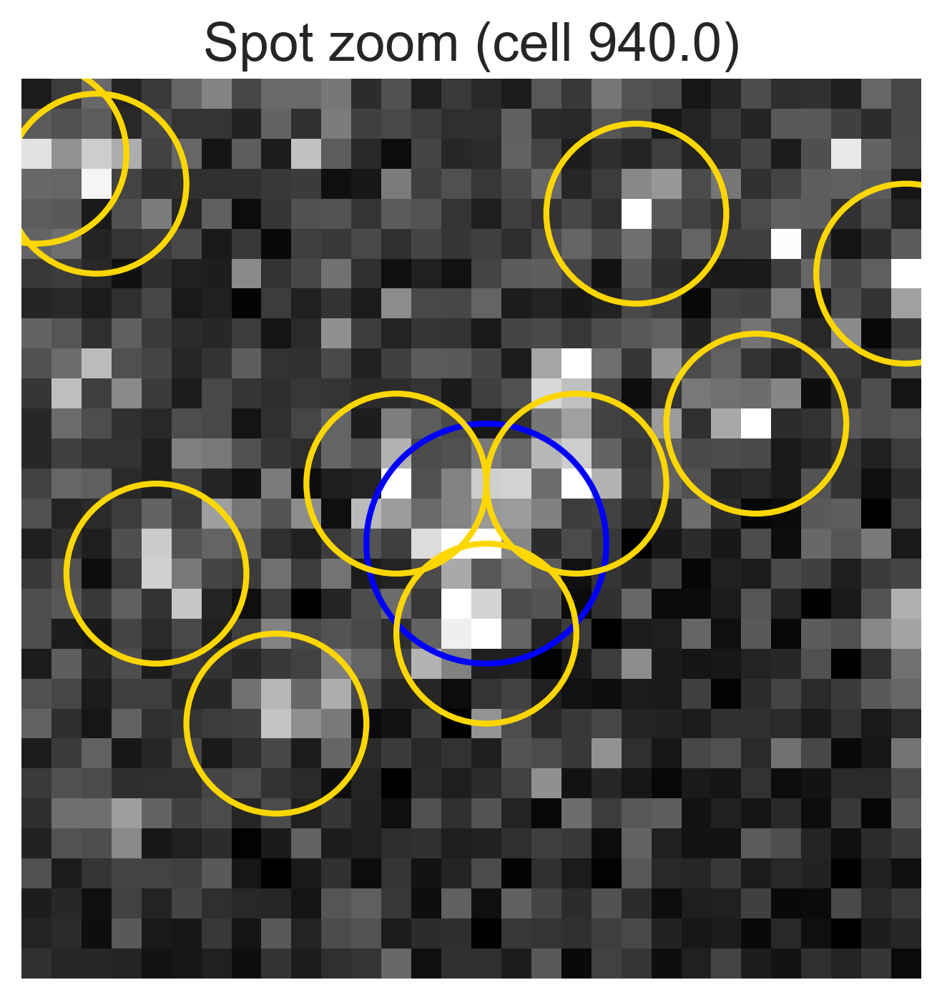

  Selected cell with removal 'Medium' from h5_idx 2.
    Displaying cell plot: NA_150_FOV16_ID1172
Chose unique_cell_id=1184.0 with TS and Spot (FOV=16).
No Foci in this cell


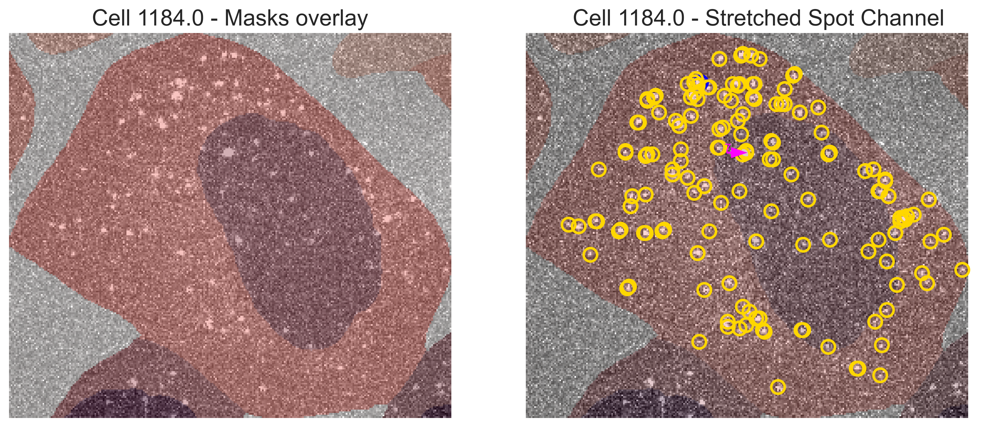

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 1172.


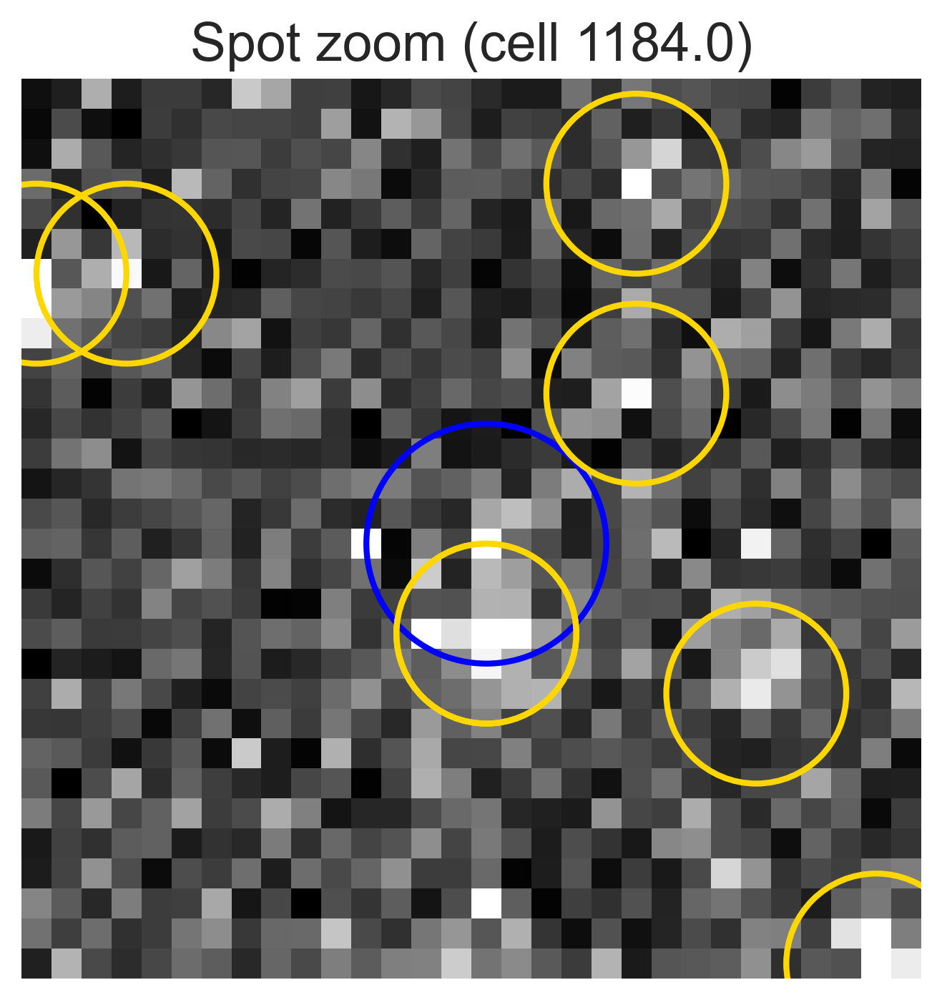

  Selected cell with removal 'Low' from h5_idx 2.
    Displaying cell plot: NA_150_FOV15_ID1160
Chose unique_cell_id=1158.0 with TS and Spot (FOV=15).
No Foci in this cell


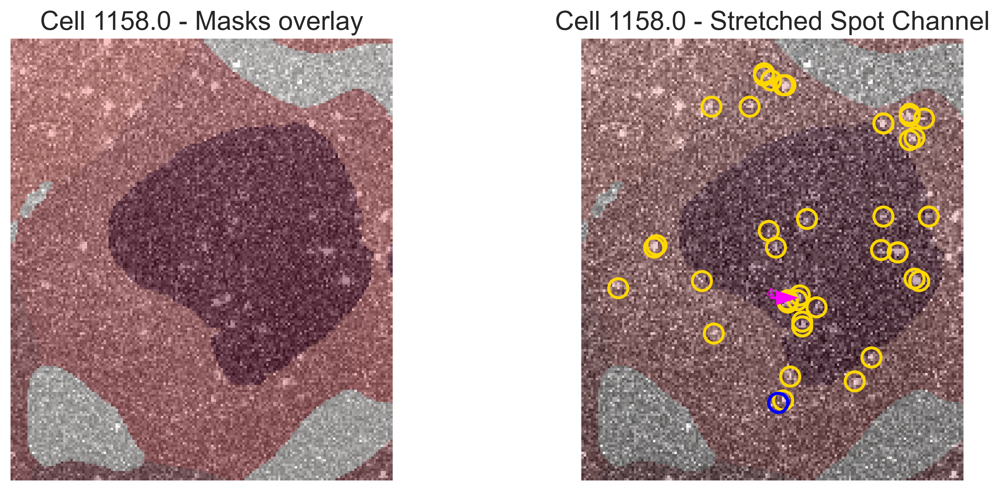

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 1160.


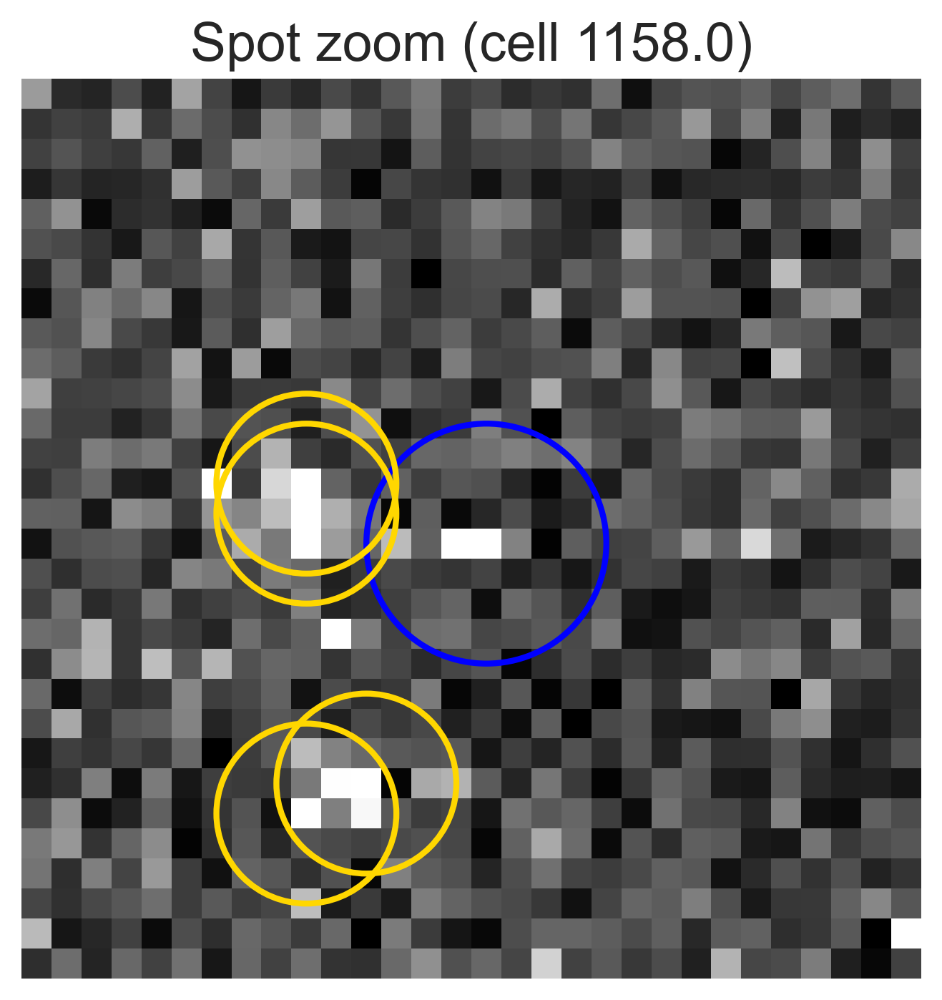


Processing h5_idx 3
  Selected cell with removal 'High' from h5_idx 3.
    Displaying cell plot: NA_75_FOV9_ID1542
Chose unique_cell_id=1552.0 with TS, Foci, and Spot (FOV=9).


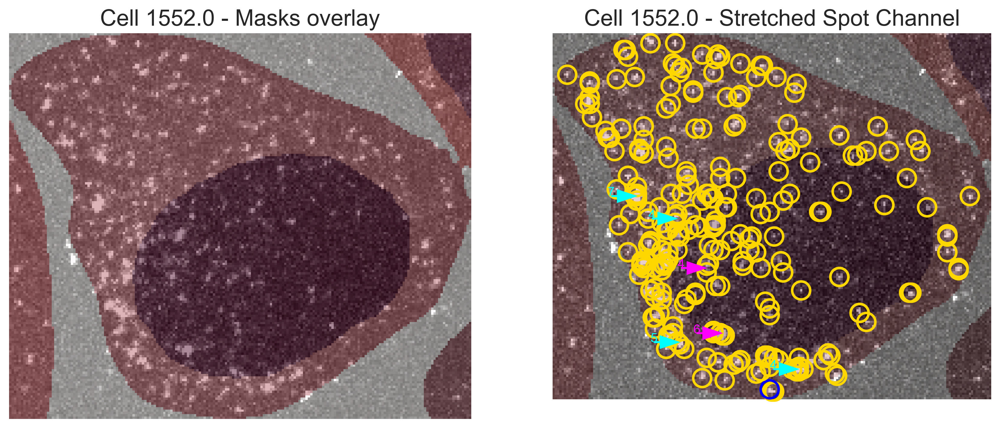

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 1542.


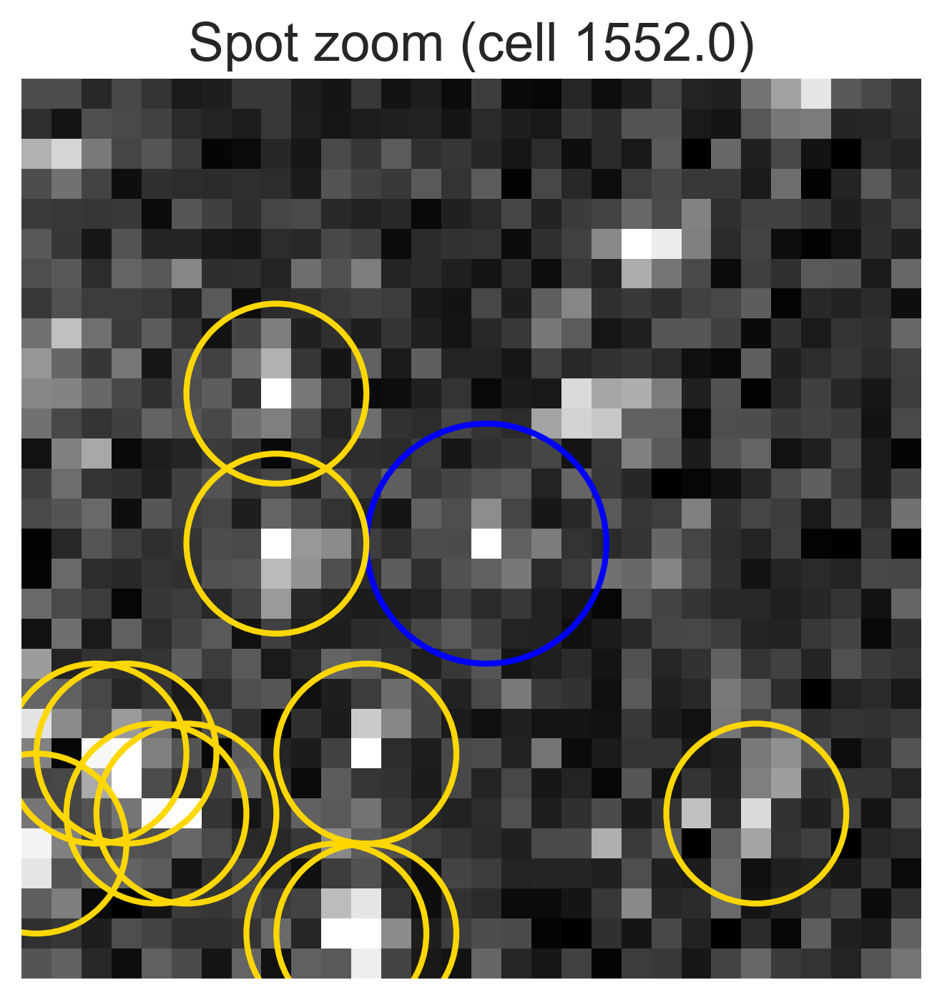

  Selected cell with removal 'Medium' from h5_idx 3.
    Displaying cell plot: NA_75_FOV6_ID1502
Chose unique_cell_id=1505.0 with TS, Foci, and Spot (FOV=6).


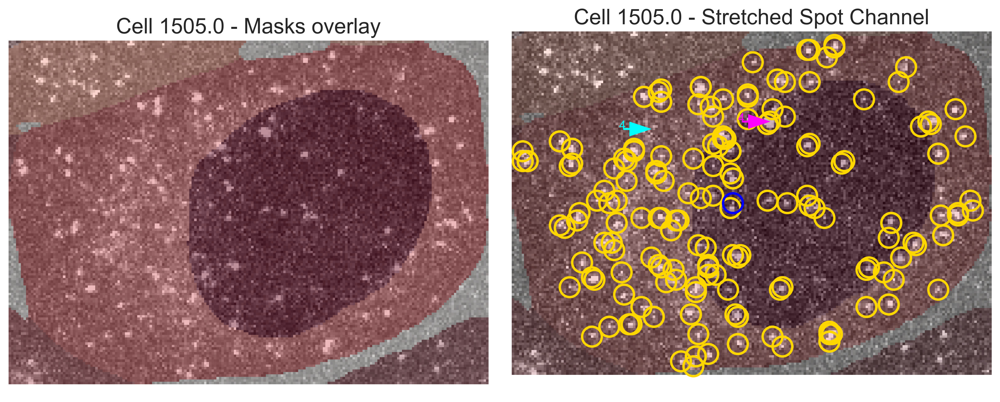

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 1502.


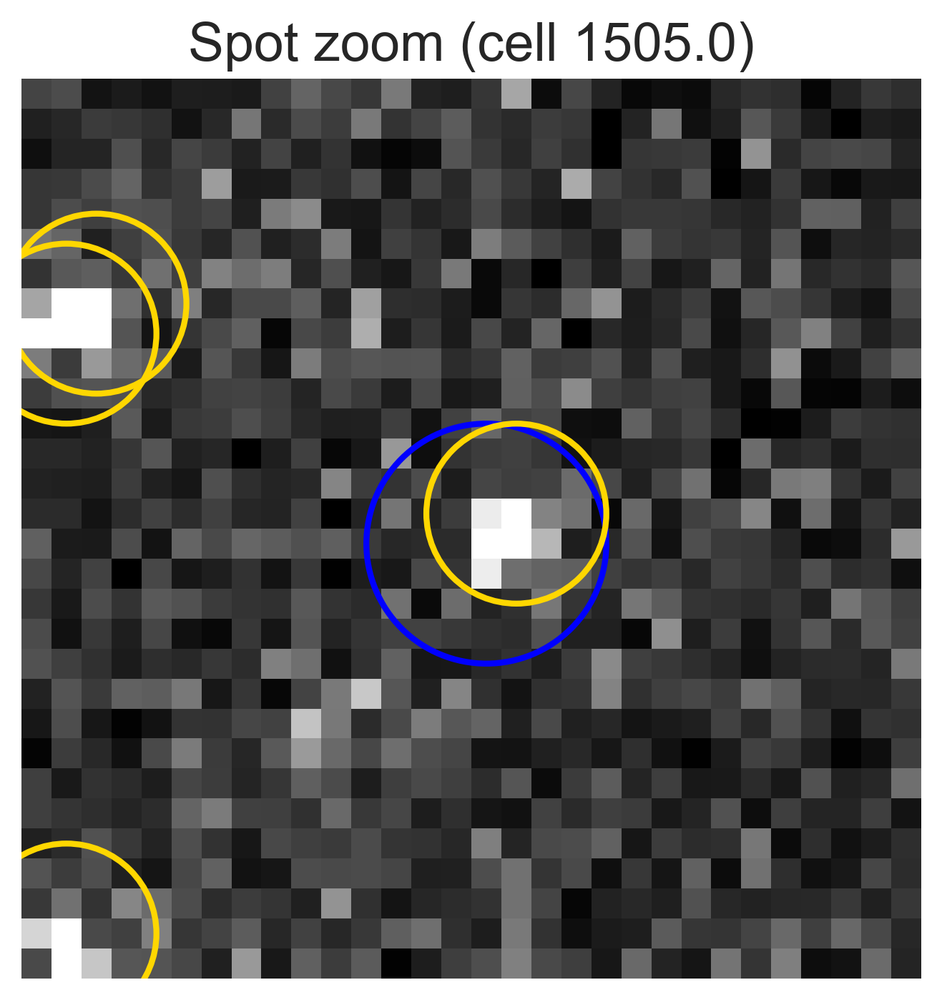

  Selected cell with removal 'Low' from h5_idx 3.
    Displaying cell plot: NA_75_FOV0_ID1433
Chose unique_cell_id=1428.0 with TS, Foci, and Spot (FOV=0).


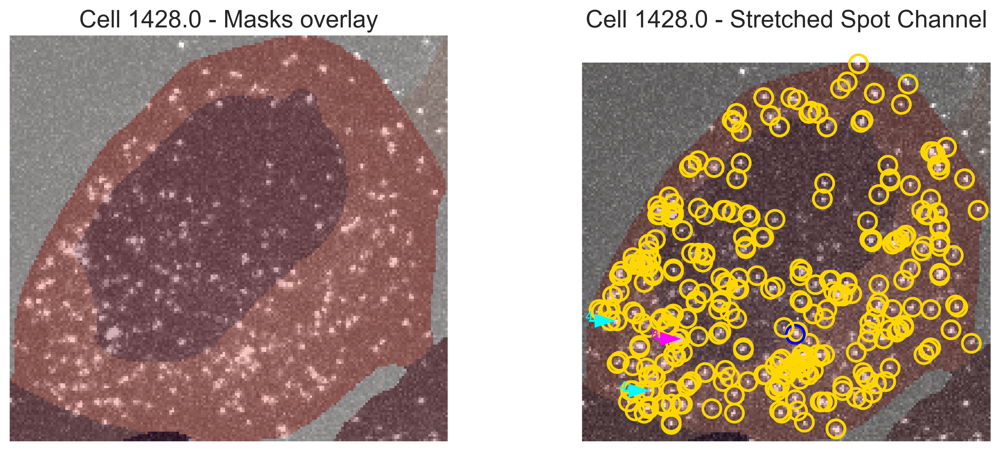

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 1433.


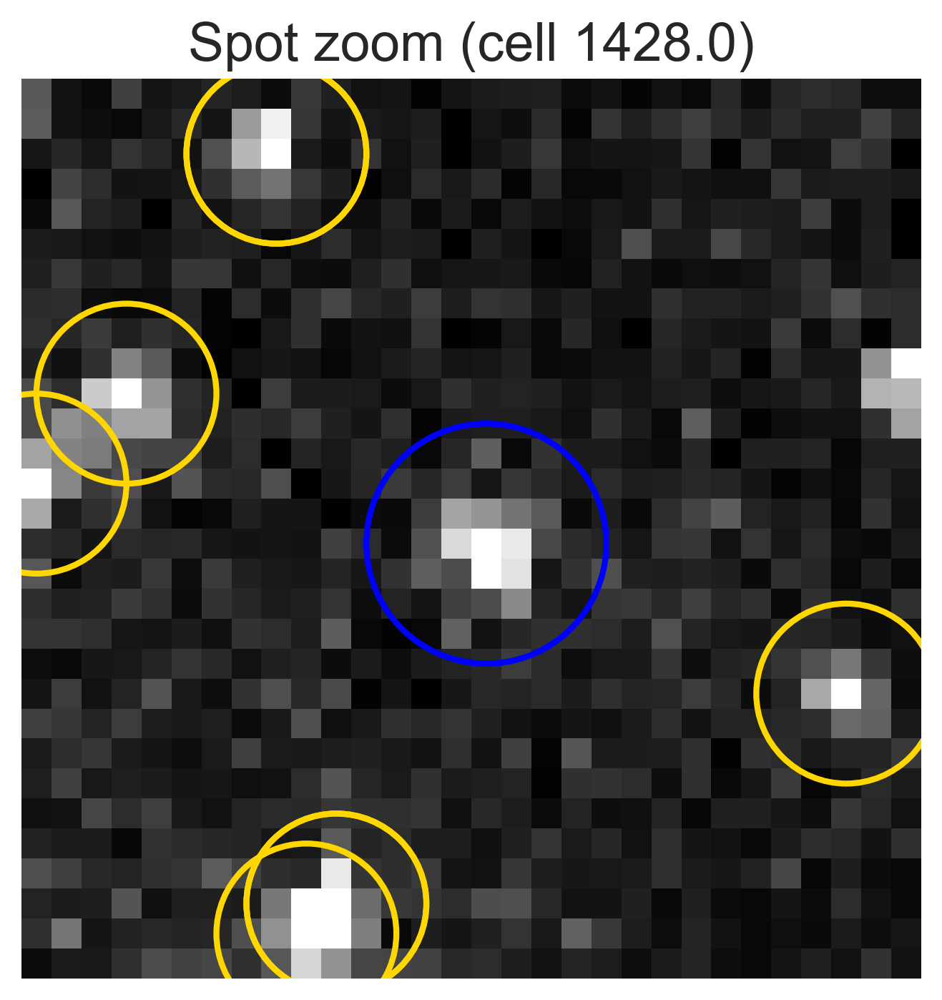


Processing h5_idx 4
  Selected cell with removal 'High' from h5_idx 4.
    Displaying cell plot: NA_0_FOV17_ID2126
Chose unique_cell_id=2128.0 with Spot only (FOV=17).
No Foci in this cell


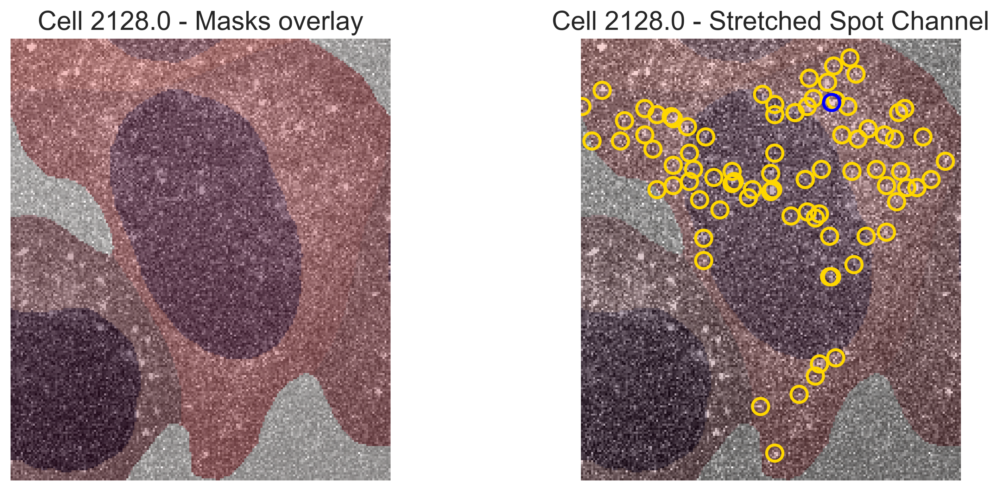

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 2126.


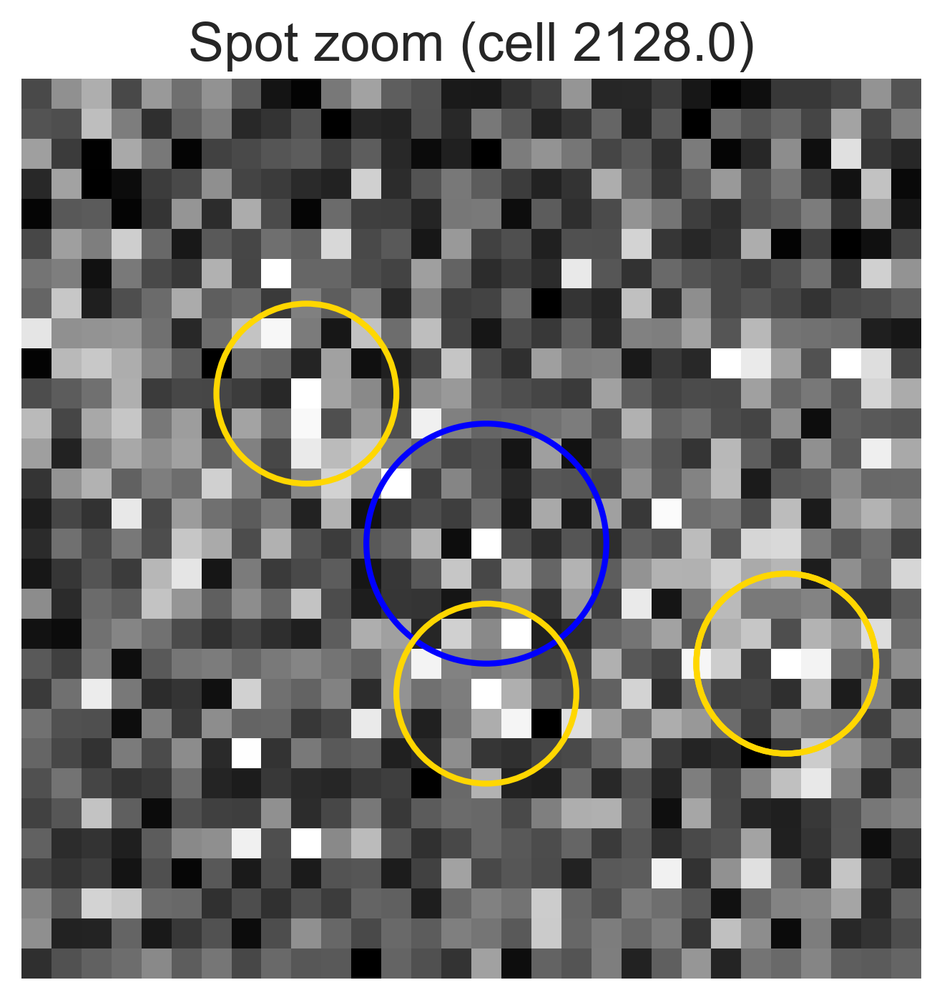

  Selected cell with removal 'Medium' from h5_idx 4.
    Displaying cell plot: NA_0_FOV2_ID1864
Chose unique_cell_id=1867.0 with Spot only (FOV=2).
No Foci in this cell


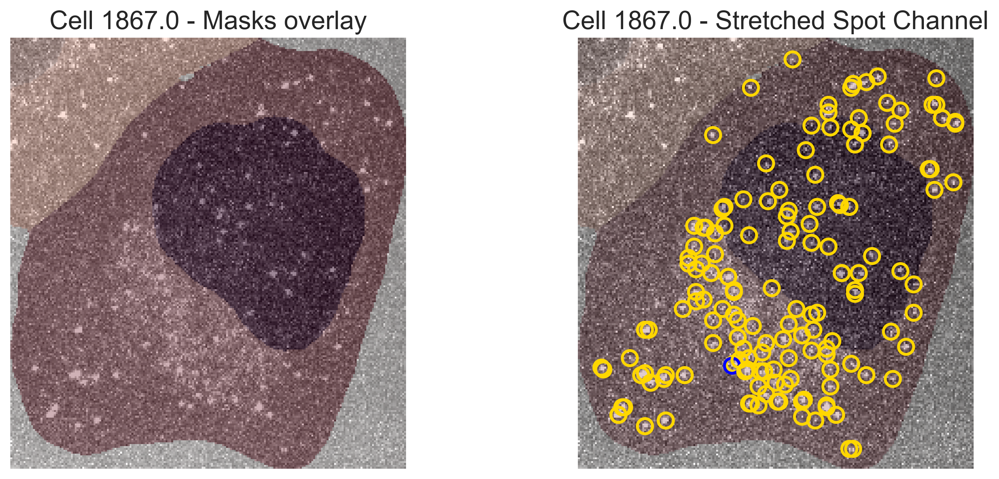

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 1864.


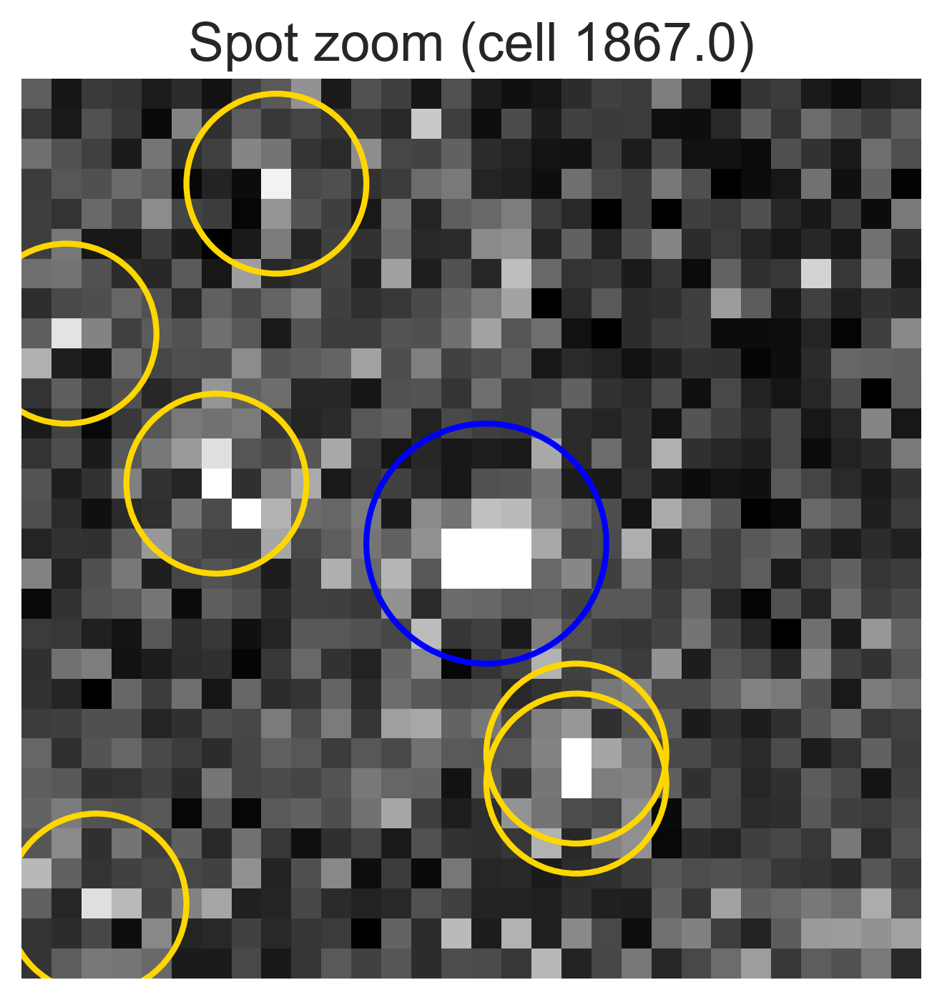

  Selected cell with removal 'Low' from h5_idx 4.
    Displaying cell plot: NA_0_FOV8_ID1982
Chose unique_cell_id=1959.0 with Spot only (FOV=8).
No Foci in this cell


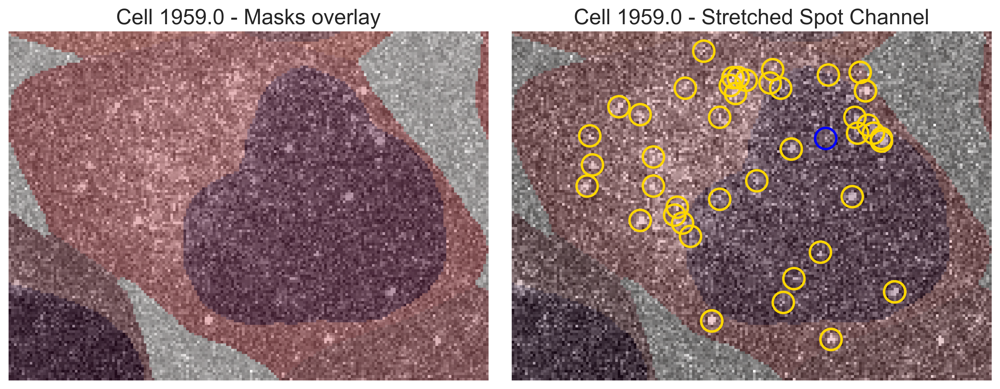

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 1982.


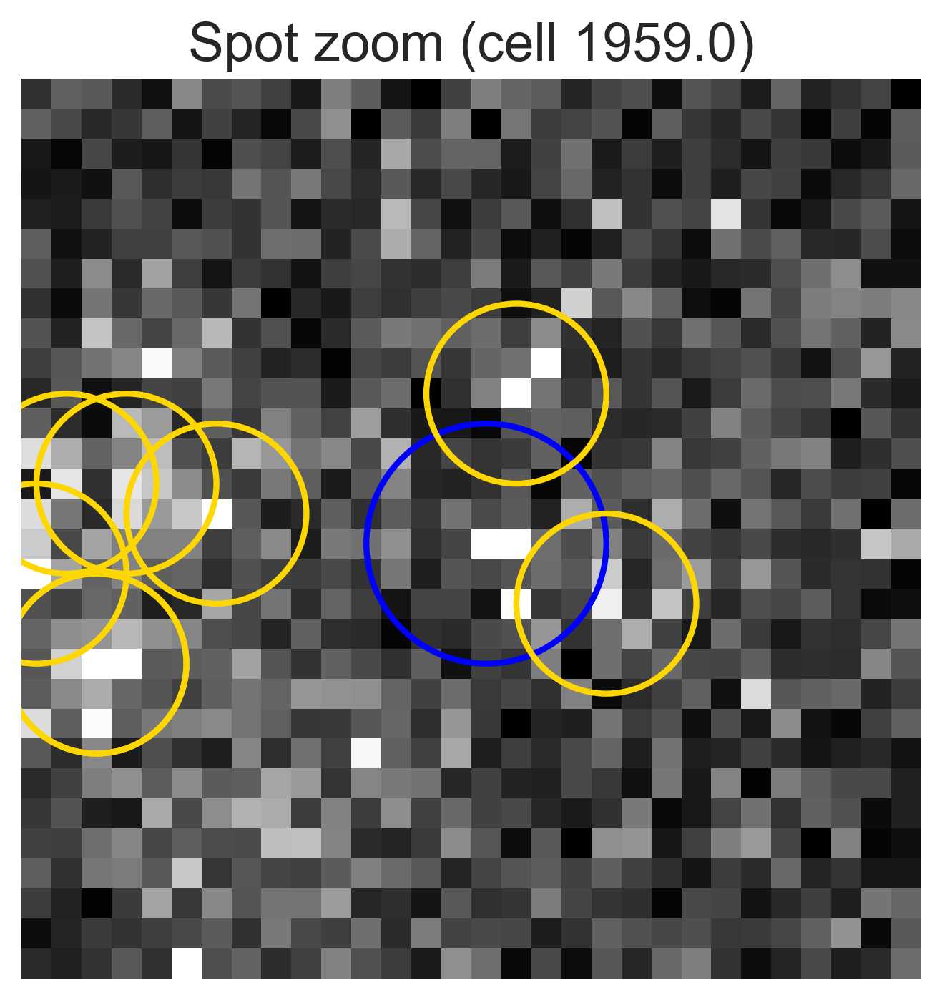


Processing h5_idx 5
  Selected cell with removal 'High' from h5_idx 5.
    Displaying cell plot: NA_20_FOV25_ID2685
Chose unique_cell_id=2694.0 with Spot only (FOV=25).
No Foci in this cell


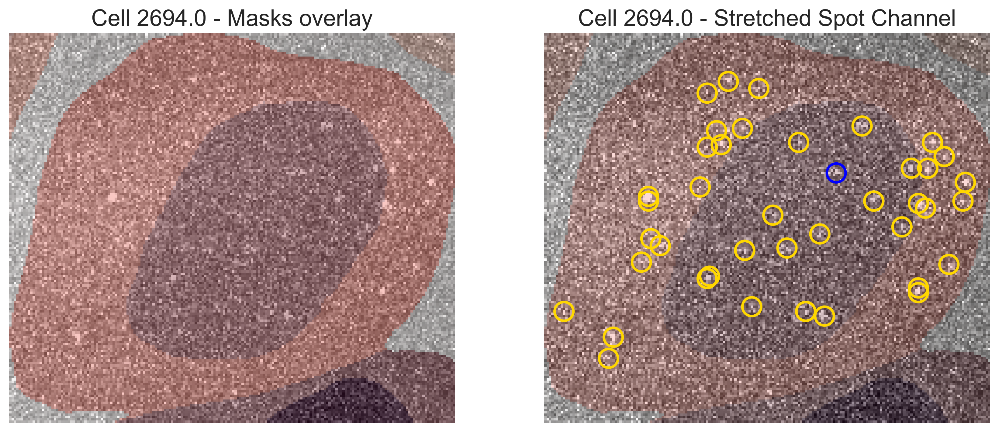

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 2685.


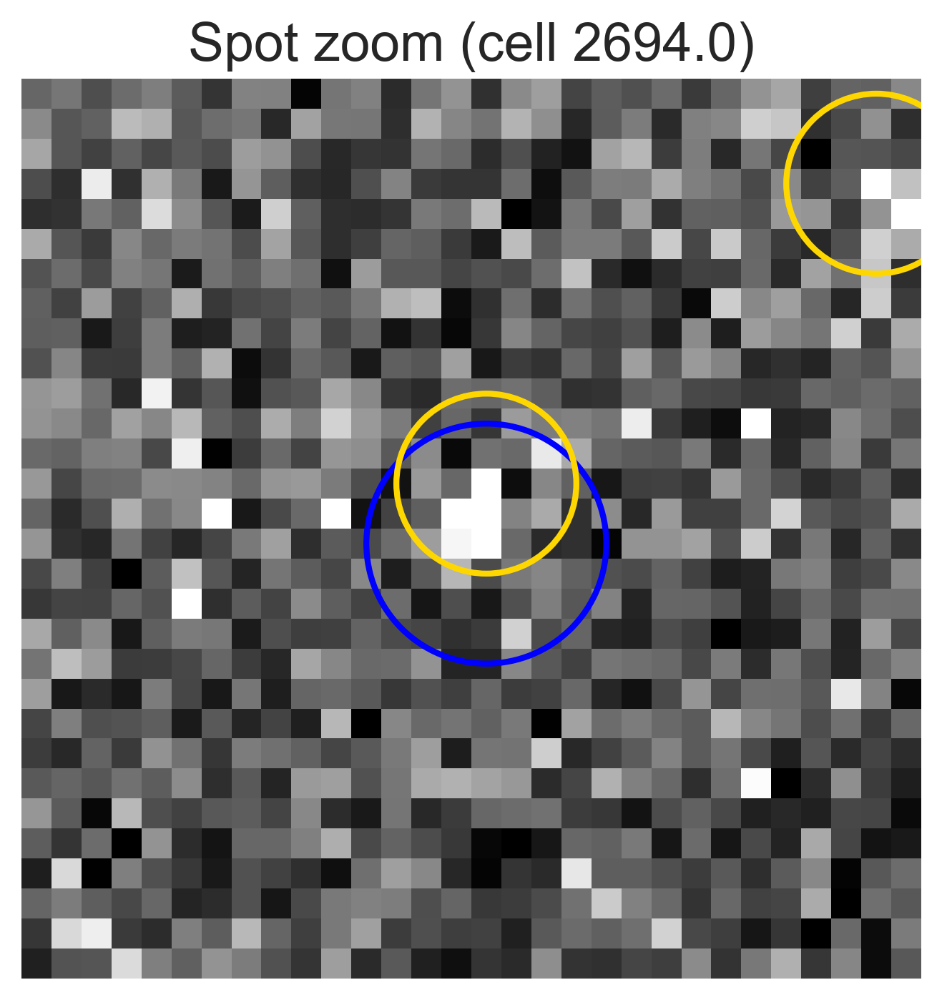

  Selected cell with removal 'Medium' from h5_idx 5.
    Displaying cell plot: NA_20_FOV6_ID2391
Chose unique_cell_id=2402.0 with TS and Spot (FOV=6).
No Foci in this cell


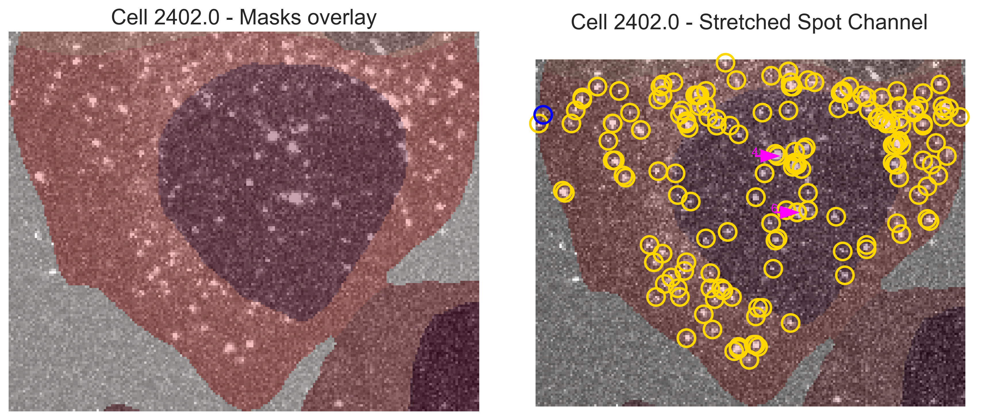

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 2391.


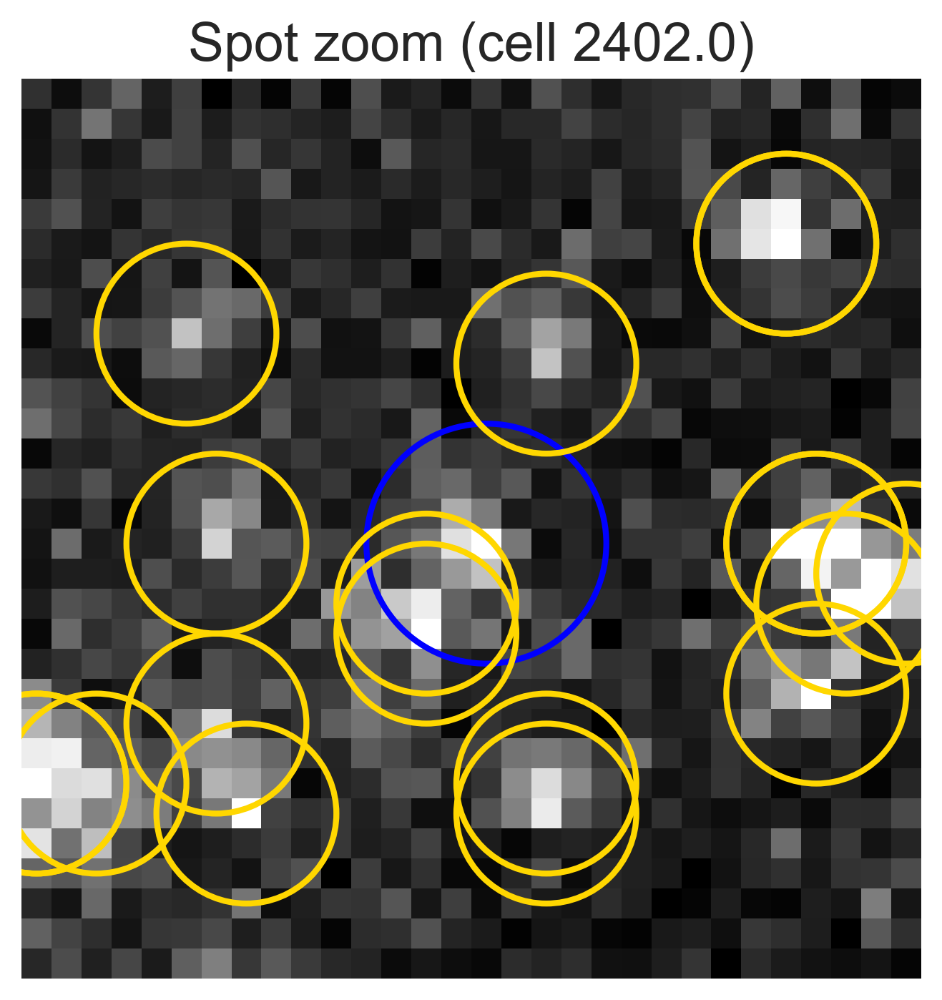

  Selected cell with removal 'Low' from h5_idx 5.
    Displaying cell plot: NA_20_FOV12_ID2496
Chose unique_cell_id=2488.0 with TS and Spot (FOV=12).
No Foci in this cell


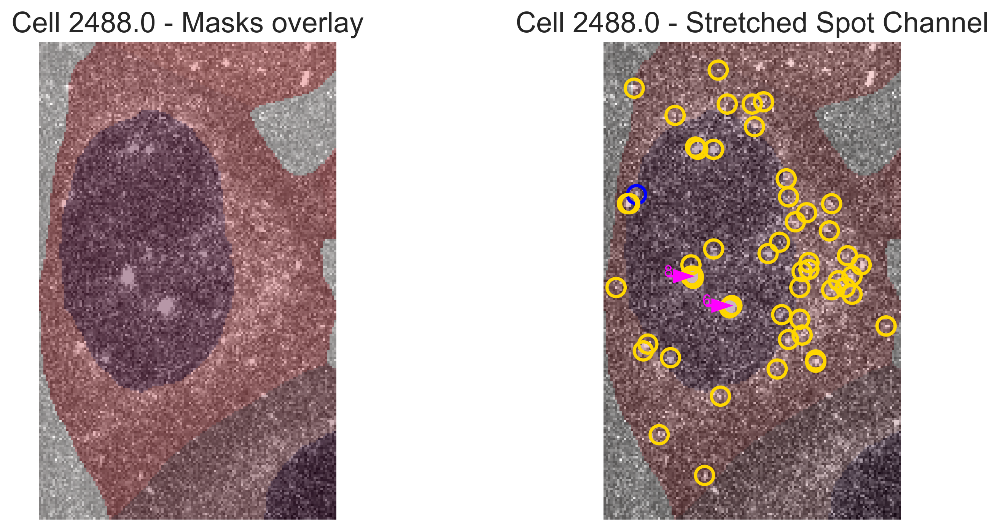

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 2496.


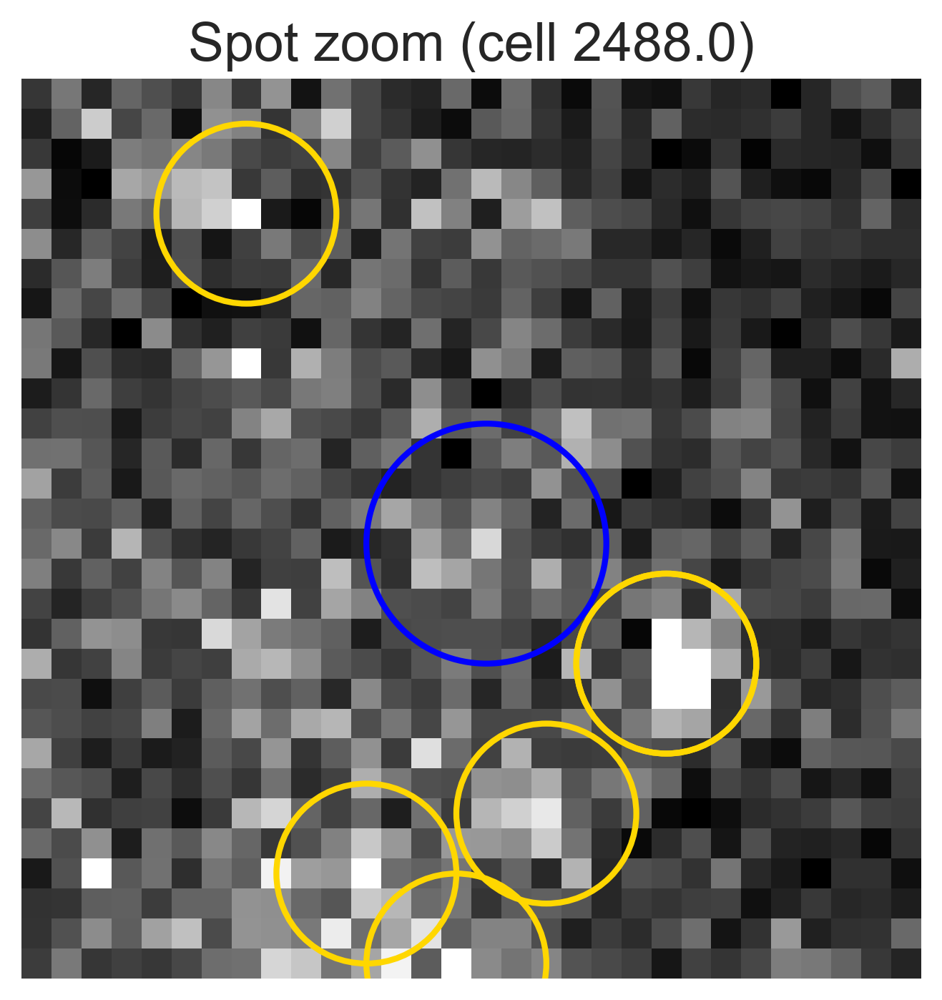


Processing h5_idx 6
  Selected cell with removal 'High' from h5_idx 6.
    Displaying cell plot: NA_30_FOV5_ID2841
Chose unique_cell_id=2840.0 with TS and Spot (FOV=5).
No Foci in this cell


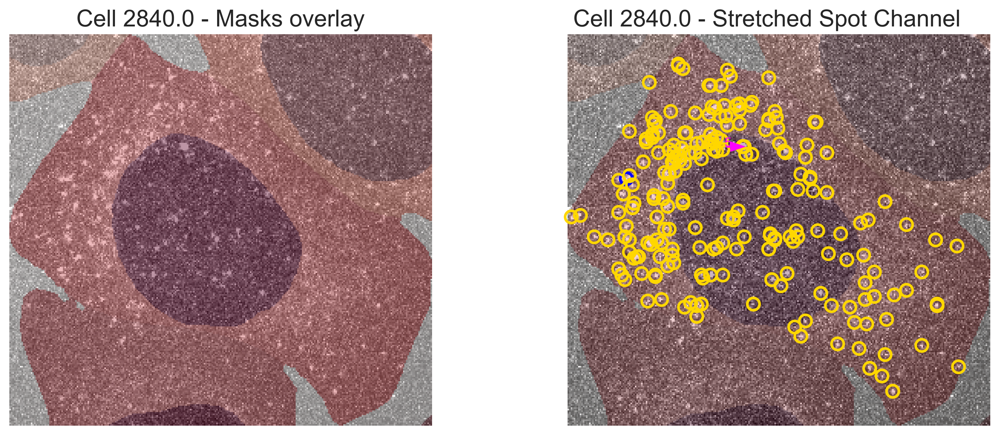

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 2841.


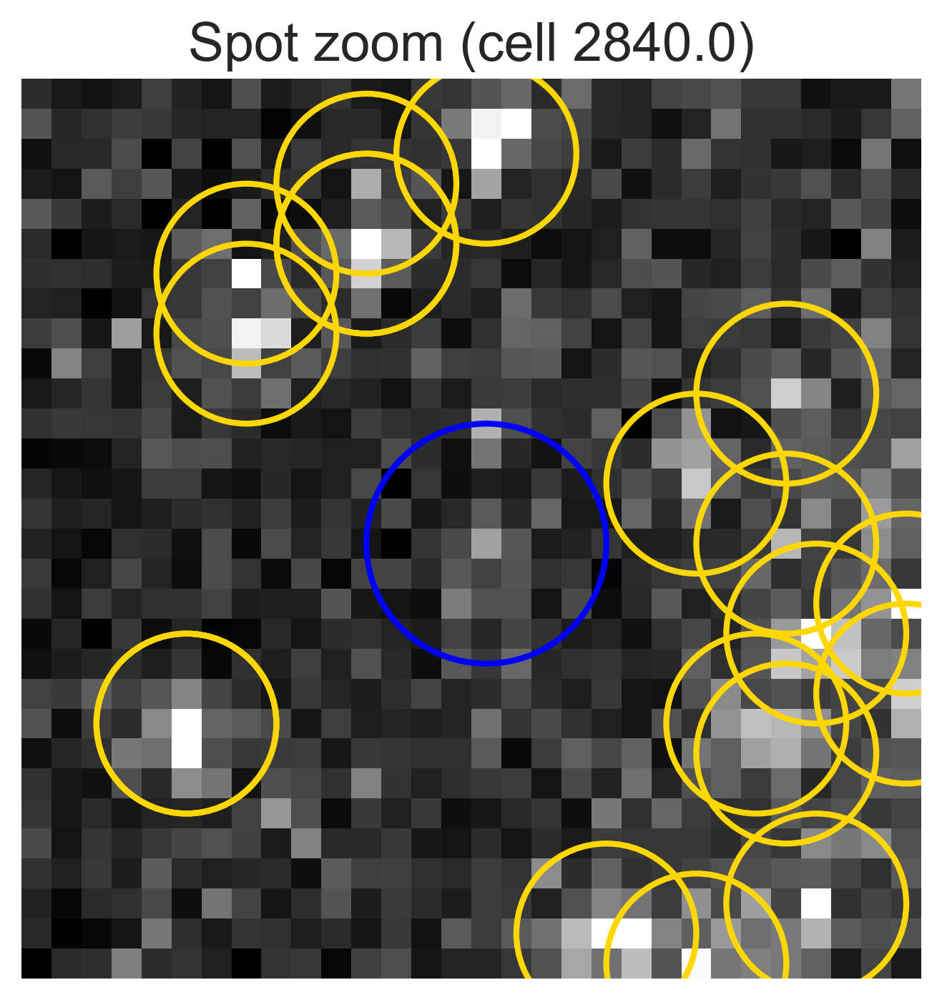

  Selected cell with removal 'Medium' from h5_idx 6.
    Displaying cell plot: NA_30_FOV9_ID2886
Chose unique_cell_id=2883.0 with TS and Spot (FOV=9).
No Foci in this cell


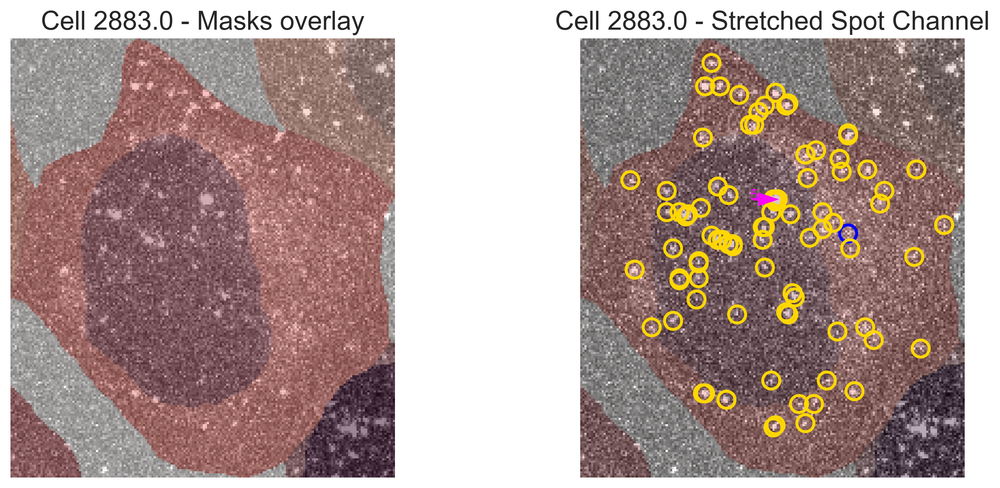

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 2886.


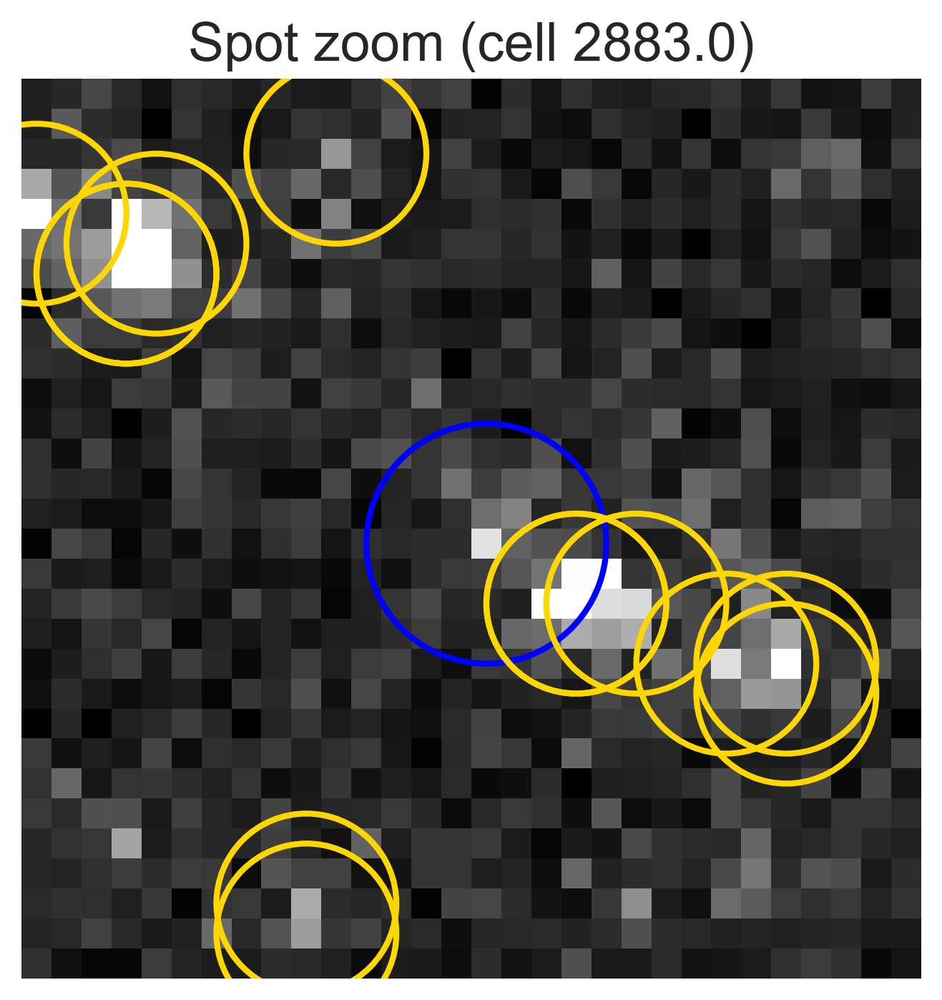

  Selected cell with removal 'Low' from h5_idx 6.
    Displaying cell plot: NA_30_FOV26_ID3138
Chose unique_cell_id=3148.0 with TS, Foci, and Spot (FOV=26).


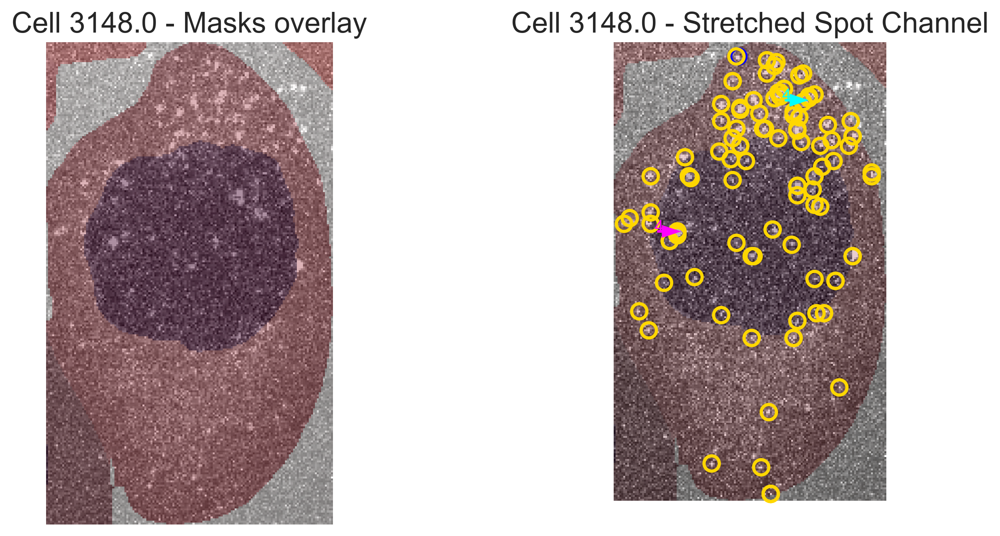

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 3138.


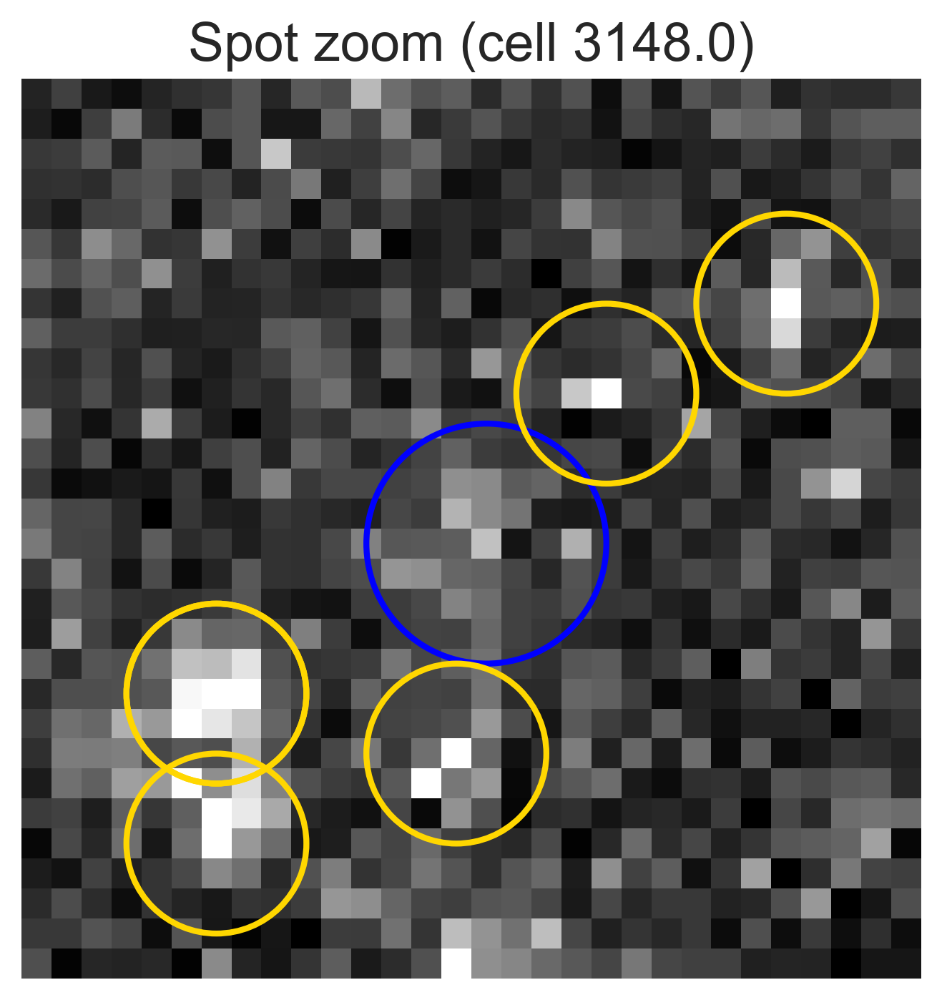


Processing h5_idx 7
  Selected cell with removal 'High' from h5_idx 7.
    Displaying cell plot: NA_180_FOV10_ID3374
Chose unique_cell_id=3377.0 with TS, Foci, and Spot (FOV=10).


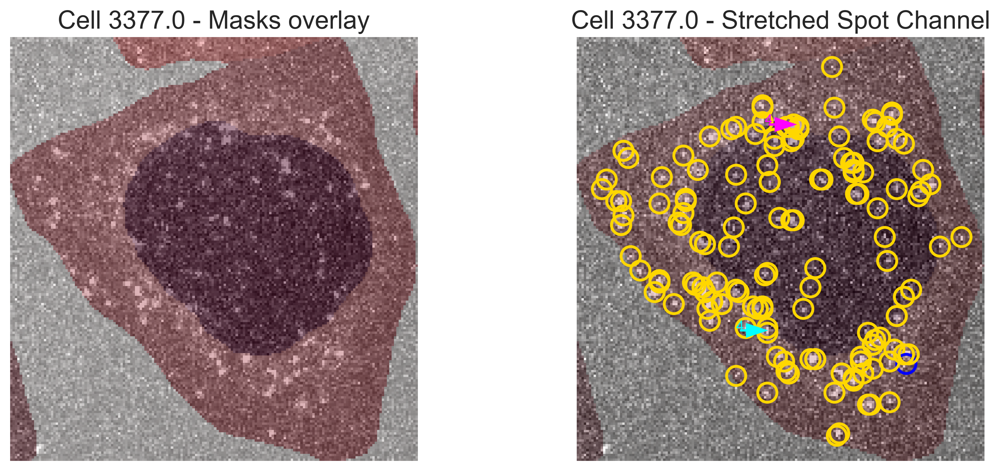

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 3374.


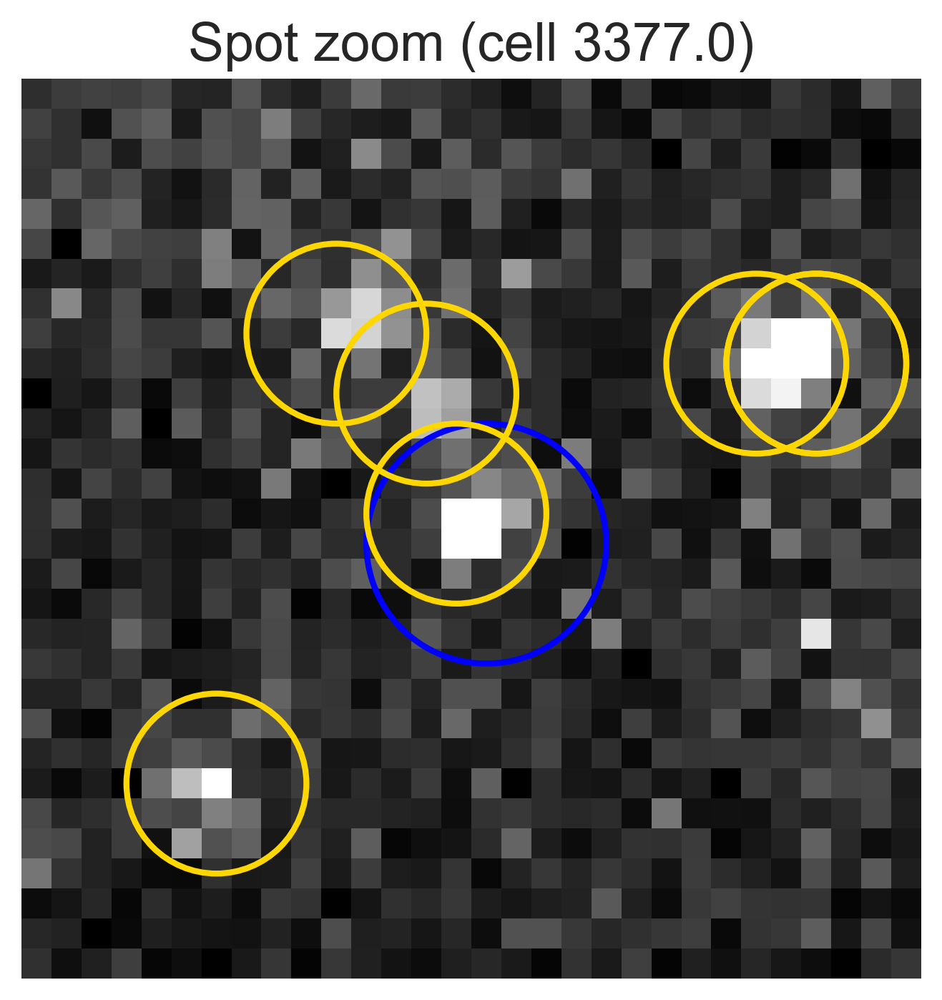

  Selected cell with removal 'Medium' from h5_idx 7.
    Displaying cell plot: NA_180_FOV12_ID3411
Chose unique_cell_id=3405.0 with TS, Foci, and Spot (FOV=12).


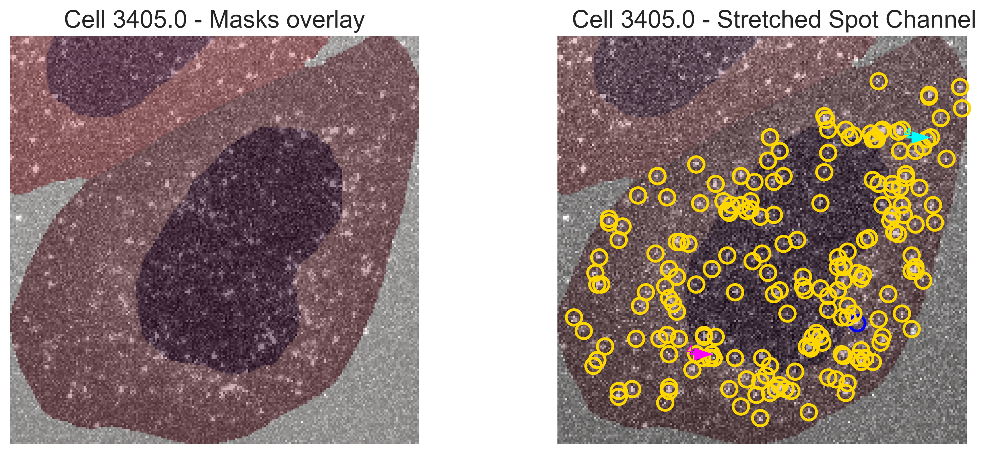

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 3411.


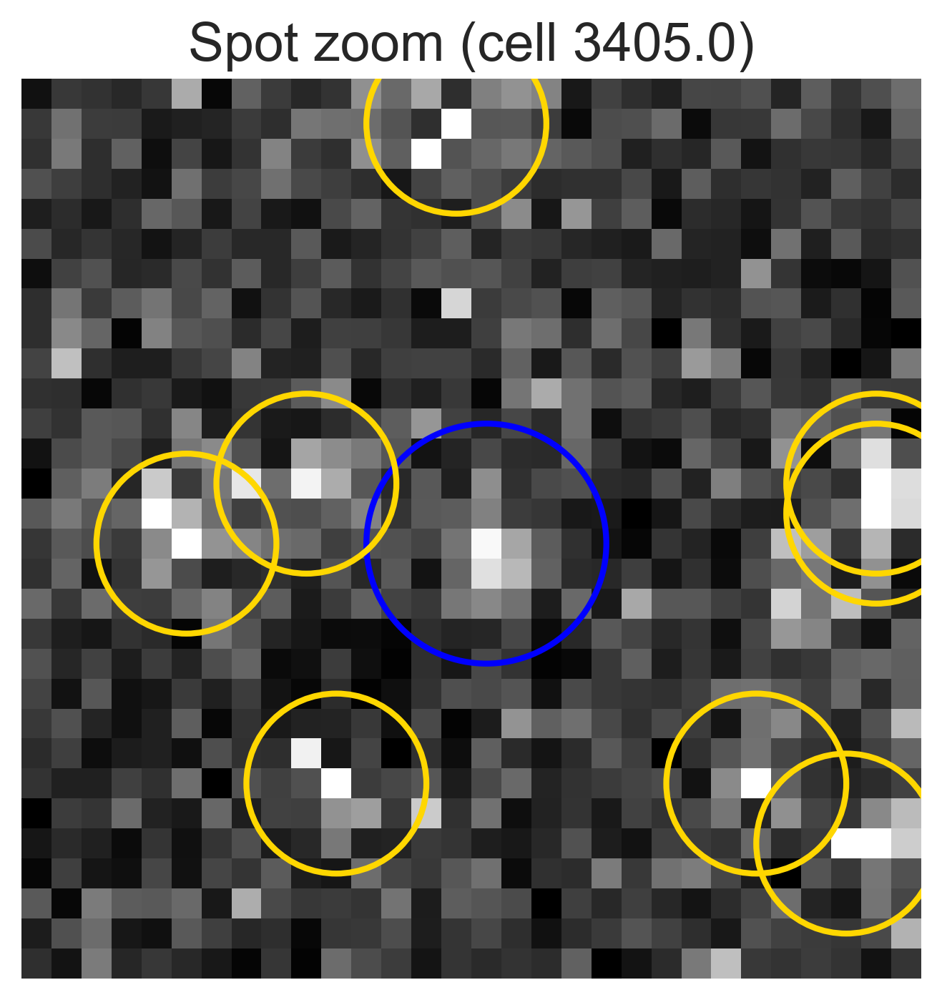

  Selected cell with removal 'Low' from h5_idx 7.
    Displaying cell plot: NA_180_FOV27_ID3654
Chose unique_cell_id=3648.0 with TS, Foci, and Spot (FOV=27).


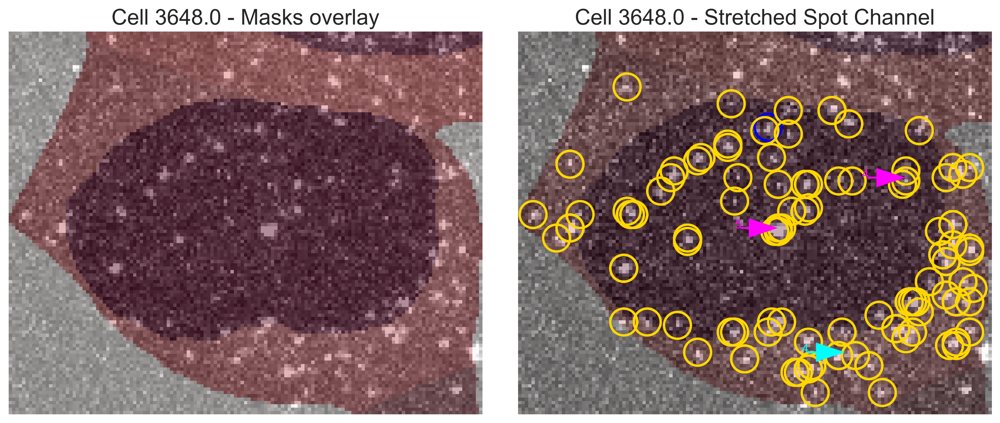

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 3654.


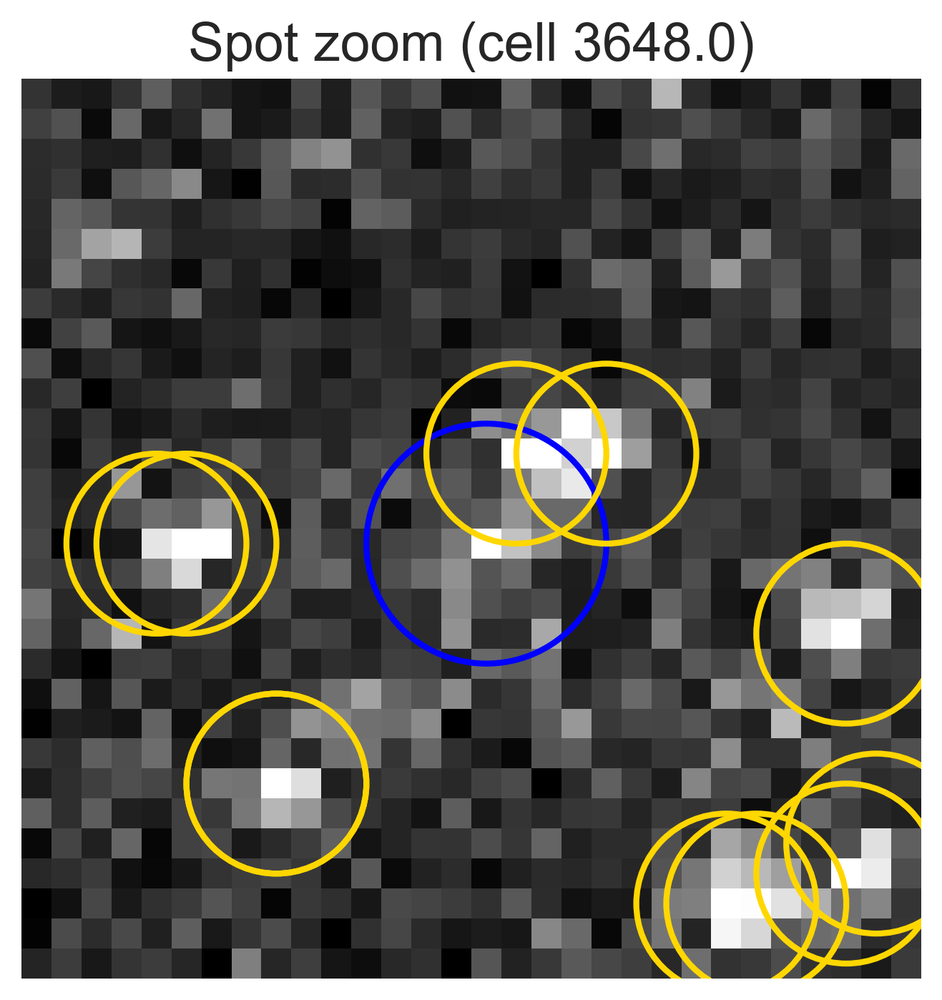


Processing h5_idx 8
  Selected cell with removal 'High' from h5_idx 8.
    Displaying cell plot: NA_10_FOV29_ID4107
Chose unique_cell_id=4113.0 with Spot only (FOV=29).
No Foci in this cell


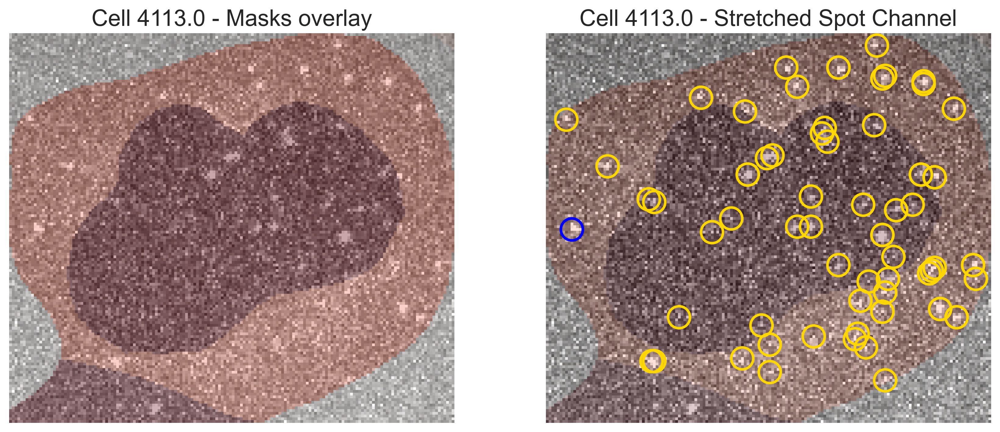

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 4107.


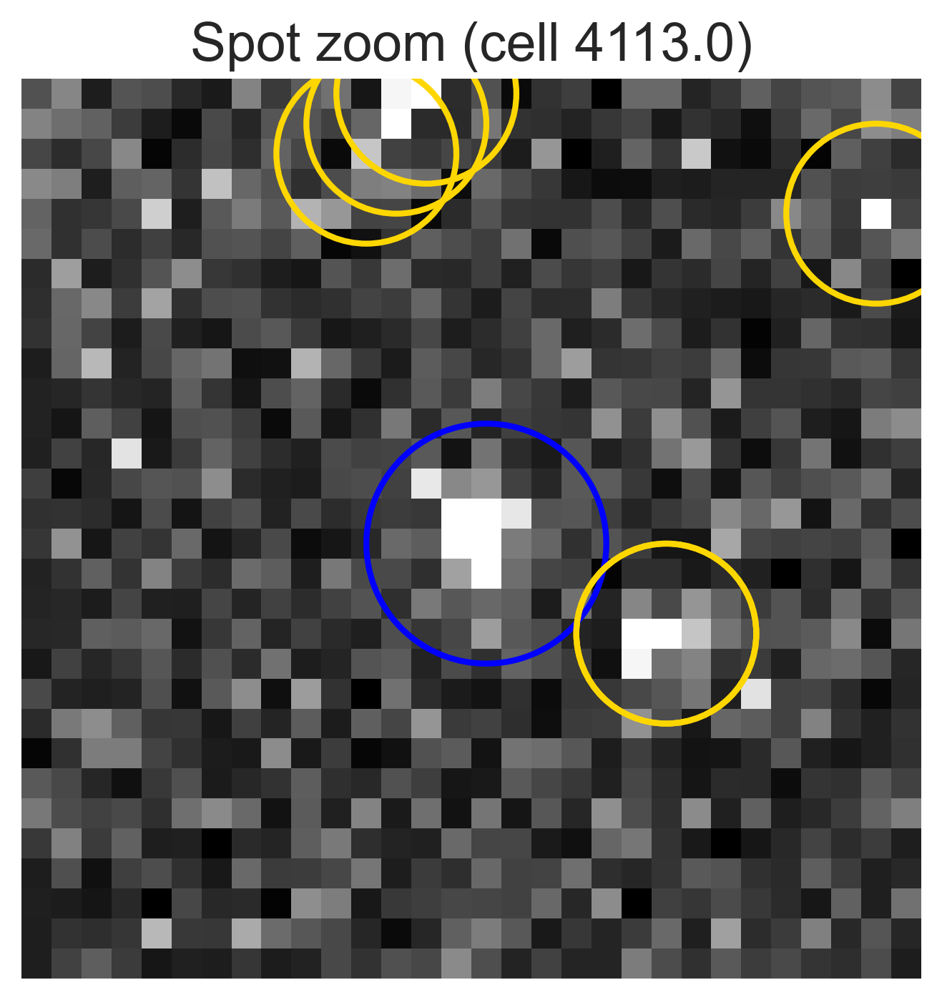

  Selected cell with removal 'Medium' from h5_idx 8.
    Displaying cell plot: NA_10_FOV26_ID4070
Chose unique_cell_id=4069.0 with TS and Spot (FOV=26).
No Foci in this cell


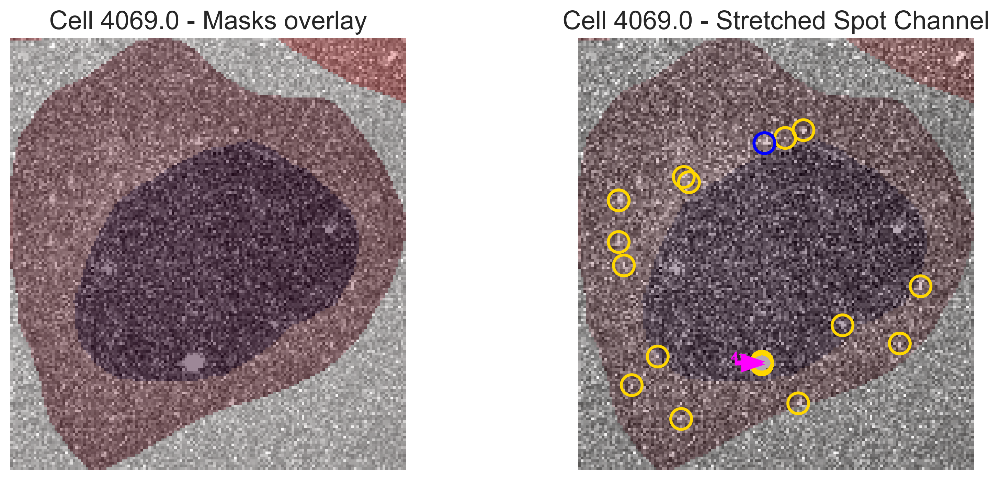

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 4070.


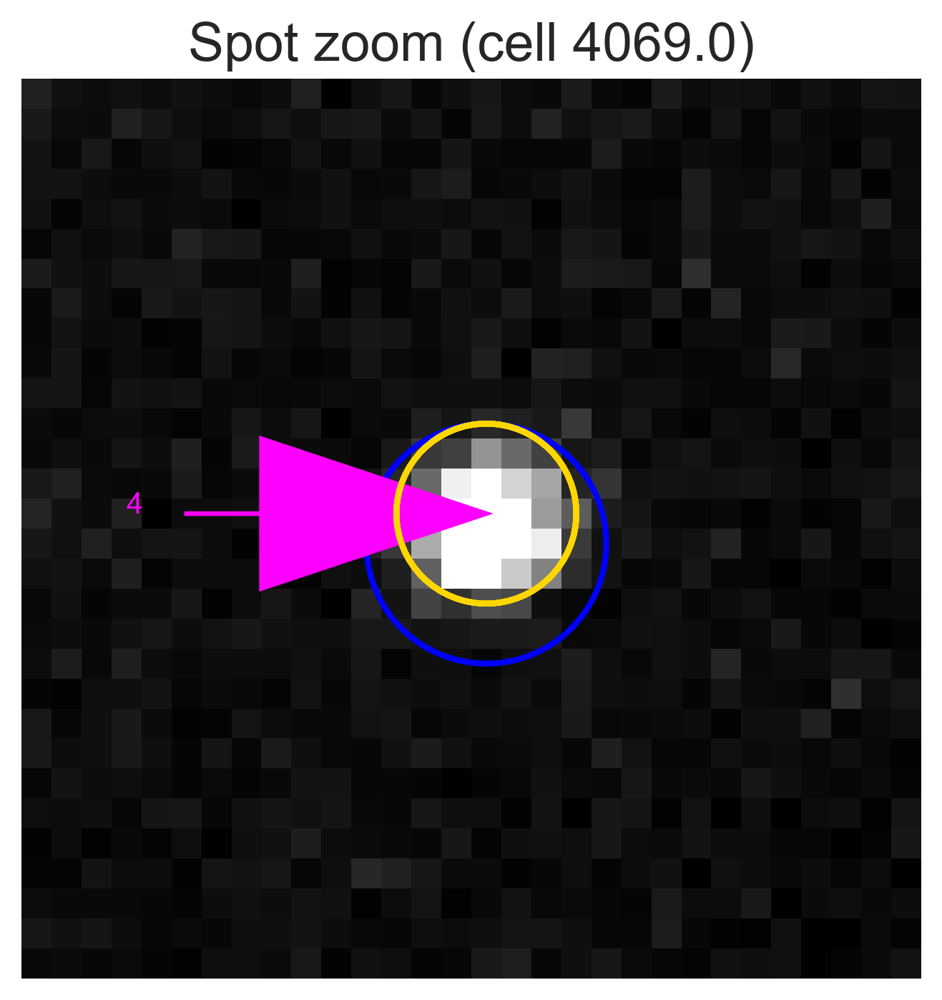

  Selected cell with removal 'Low' from h5_idx 8.
    Displaying cell plot: NA_10_FOV18_ID3960
Chose unique_cell_id=3960.0 with Spot only (FOV=18).
No Foci in this cell


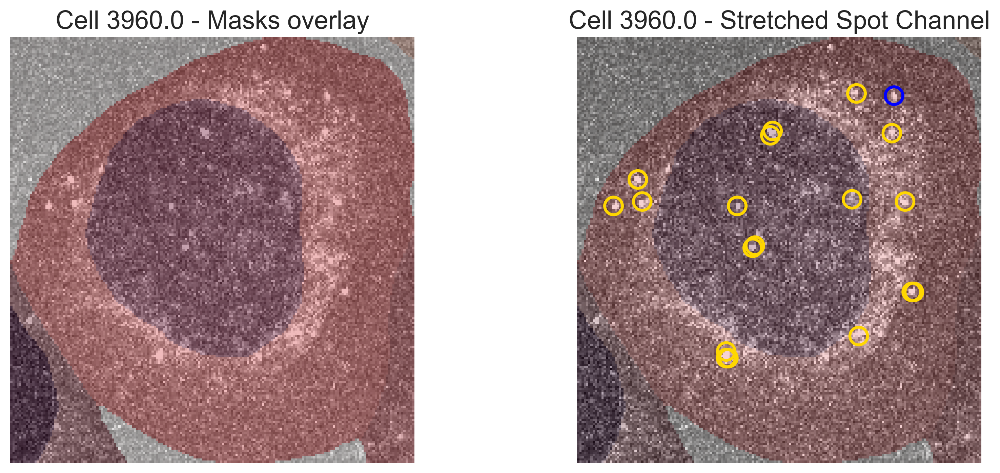

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 3960.


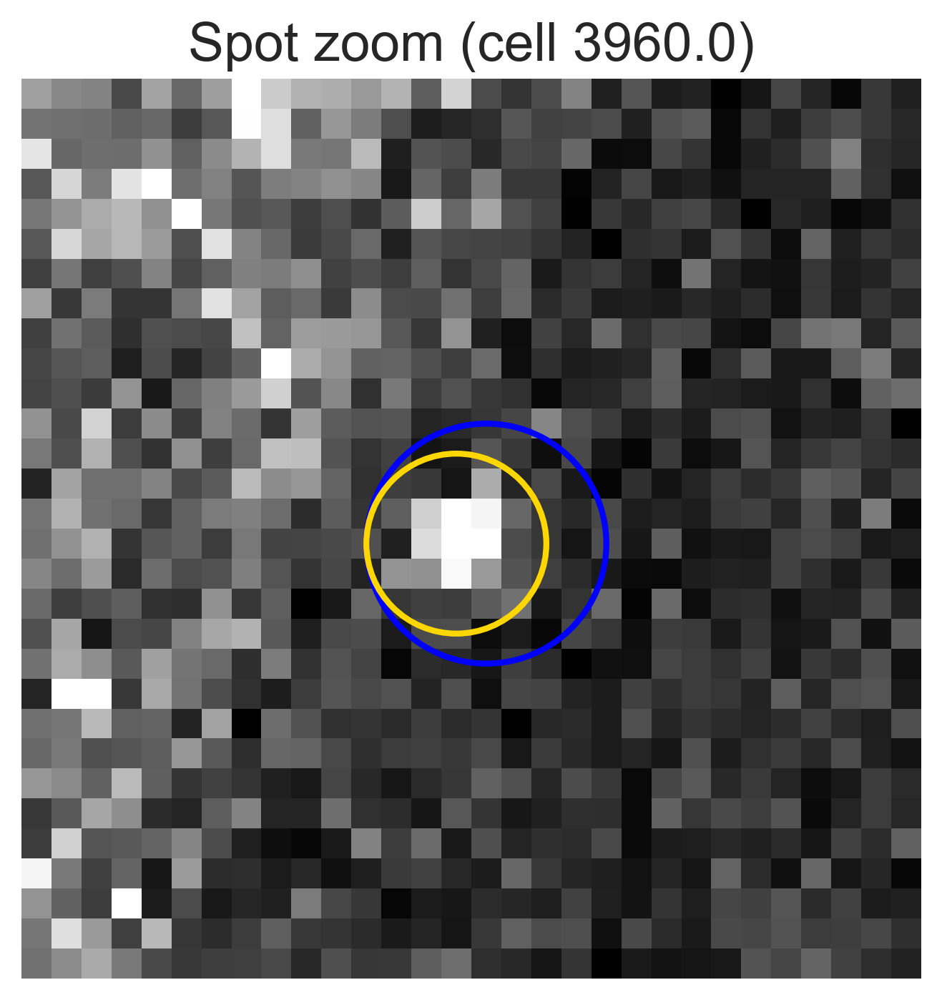


Processing h5_idx 9
  Selected cell with removal 'High' from h5_idx 9.
    Displaying cell plot: NA_60_FOV7_ID4216
Chose unique_cell_id=4216.0 with TS, Foci, and Spot (FOV=7).


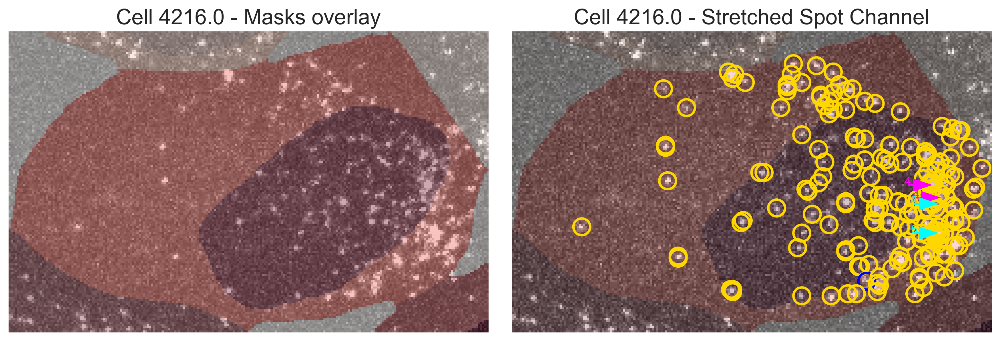

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 4216.


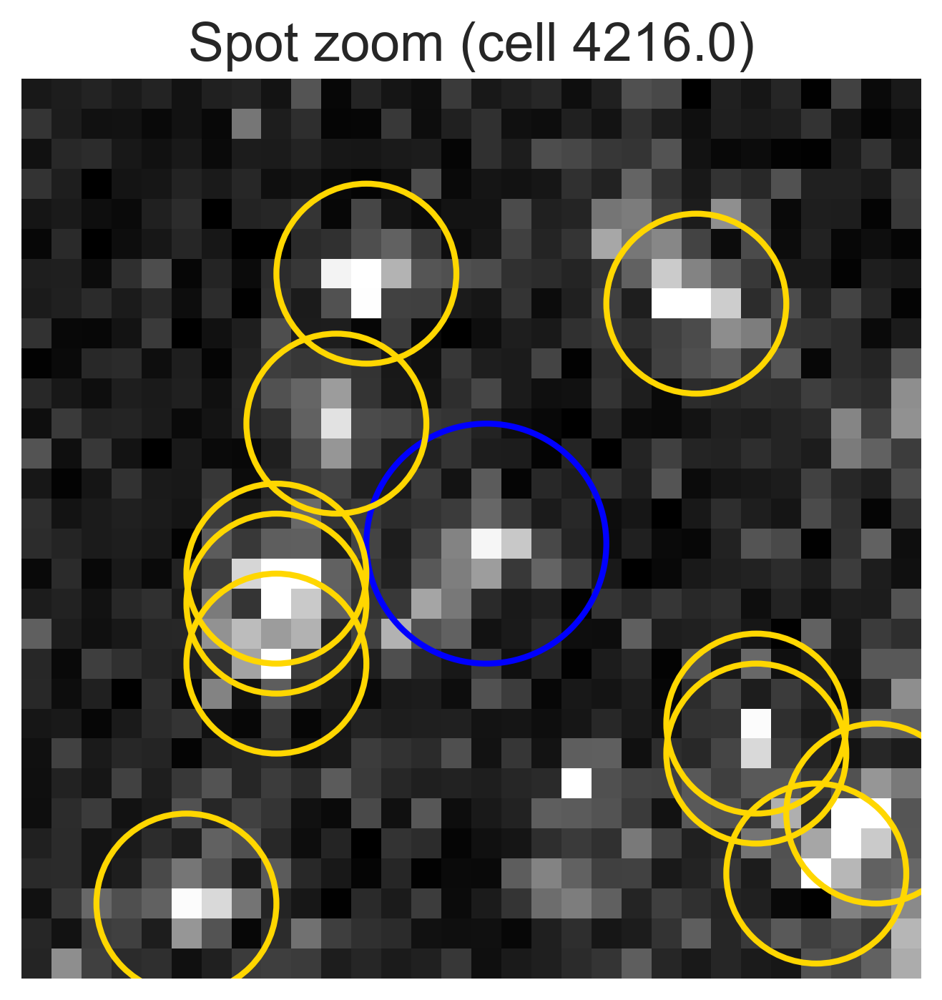

  Selected cell with removal 'Medium' from h5_idx 9.
    Displaying cell plot: NA_60_FOV15_ID4331
Chose unique_cell_id=4336.0 with TS, Foci, and Spot (FOV=15).


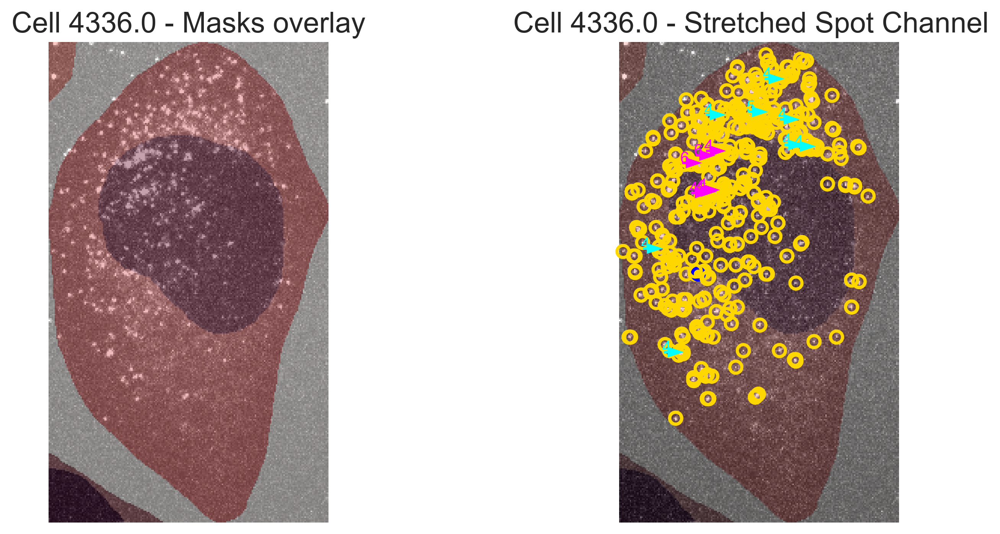

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 4331.


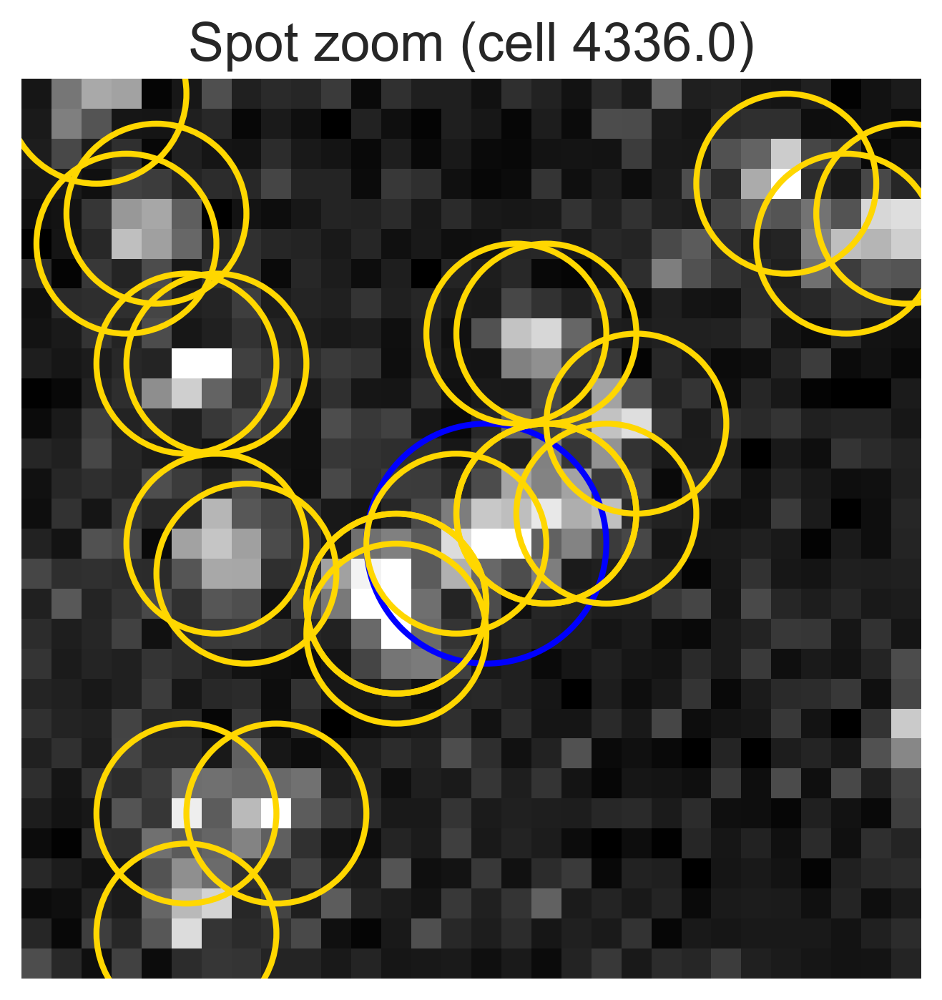

  Selected cell with removal 'Low' from h5_idx 9.
    Displaying cell plot: NA_60_FOV17_ID4362
Chose unique_cell_id=4362.0 with TS, Foci, and Spot (FOV=17).


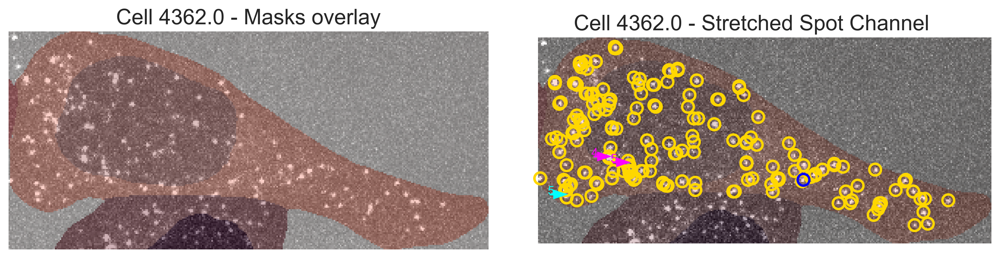

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 4362.


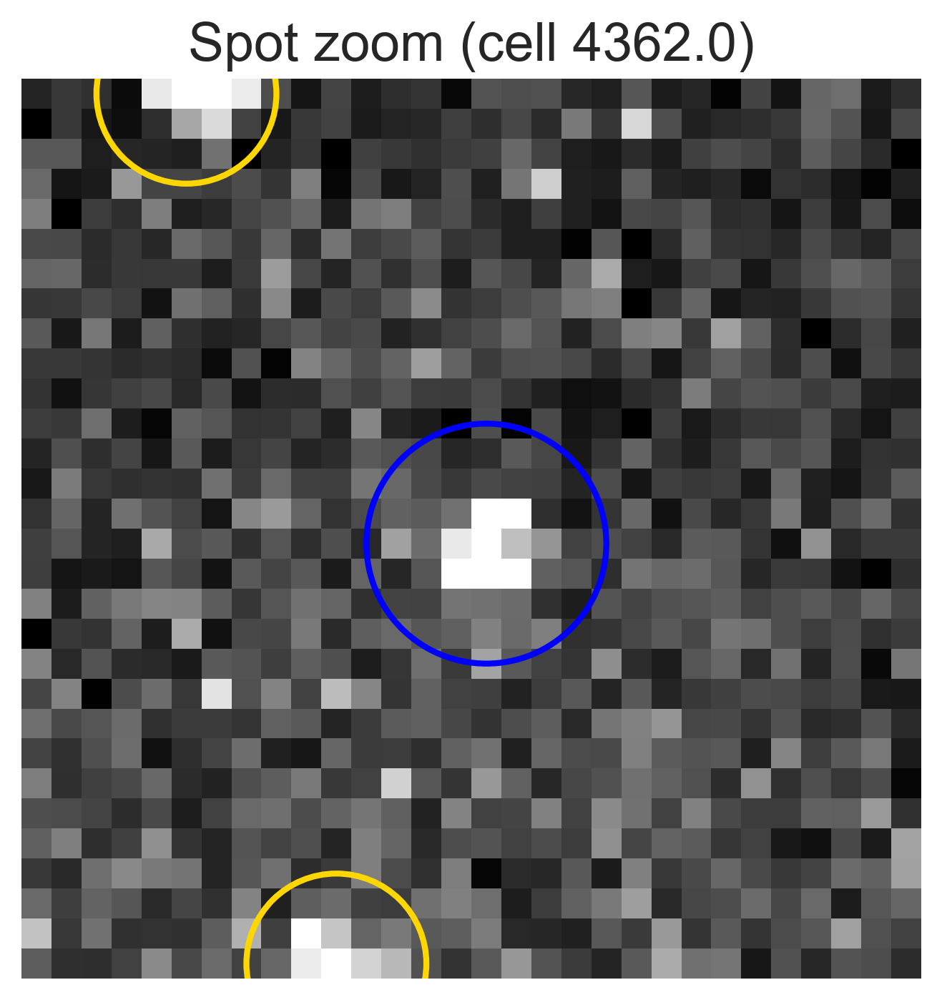


Processing h5_idx 10
  Selected cell with removal 'High' from h5_idx 10.
    Displaying cell plot: NA_50_FOV28_ID4962
Chose unique_cell_id=4958.0 with TS, Foci, and Spot (FOV=28).


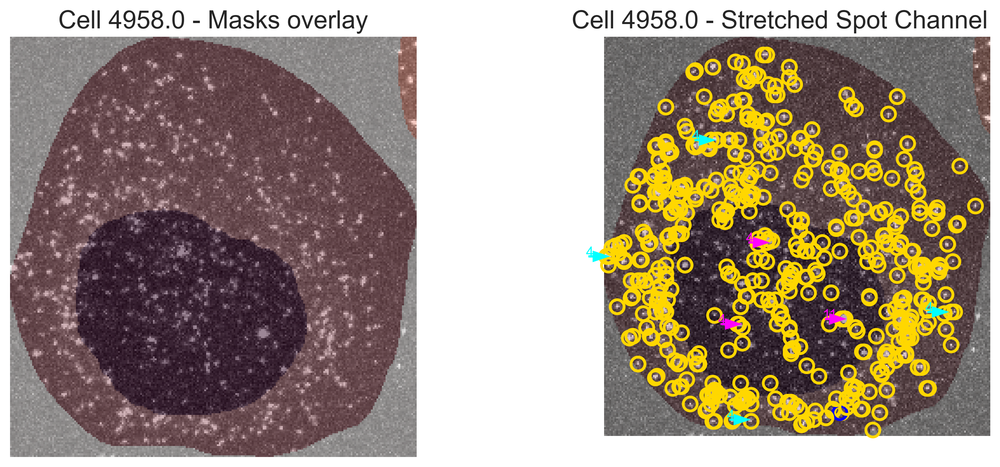

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 4962.


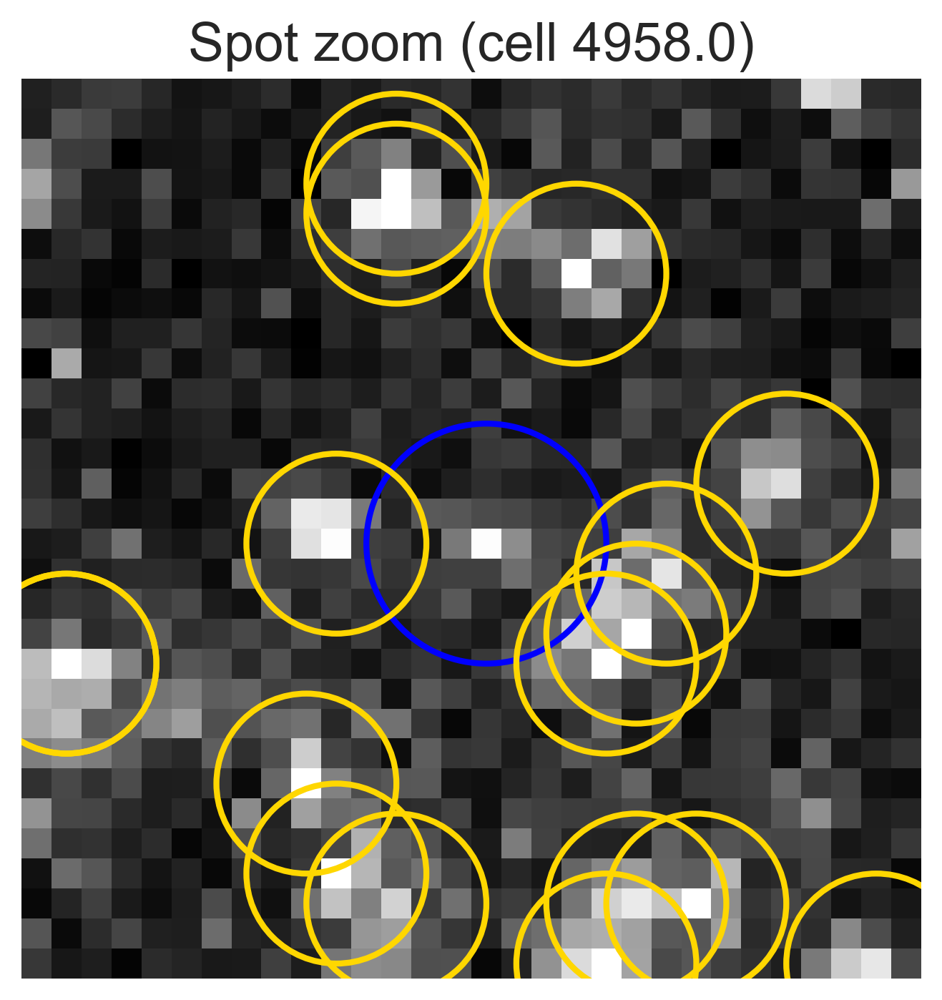

  Selected cell with removal 'Medium' from h5_idx 10.
    Displaying cell plot: NA_50_FOV11_ID4685
Chose unique_cell_id=4691.0 with TS, Foci, and Spot (FOV=11).


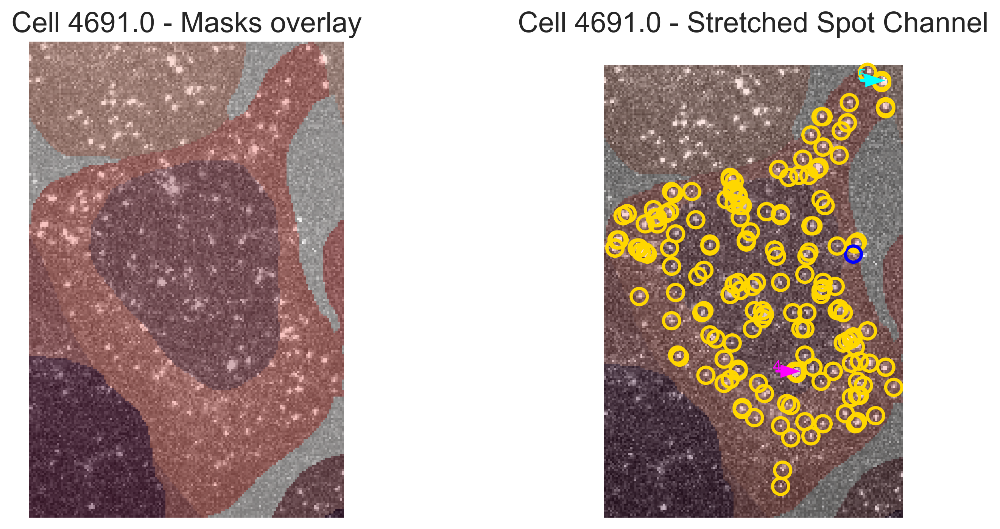

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 4685.


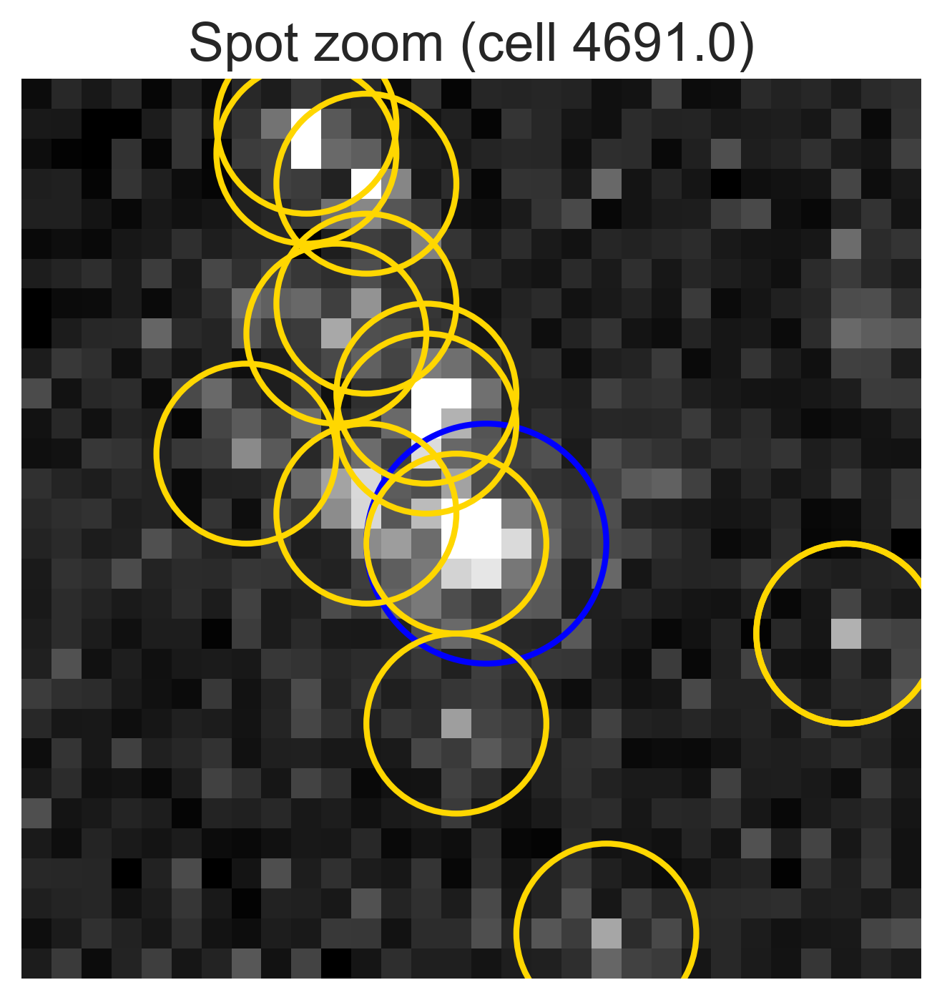

  Selected cell with removal 'Low' from h5_idx 10.
    Displaying cell plot: NA_50_FOV22_ID4872
Chose unique_cell_id=4867.0 with TS, Foci, and Spot (FOV=22).


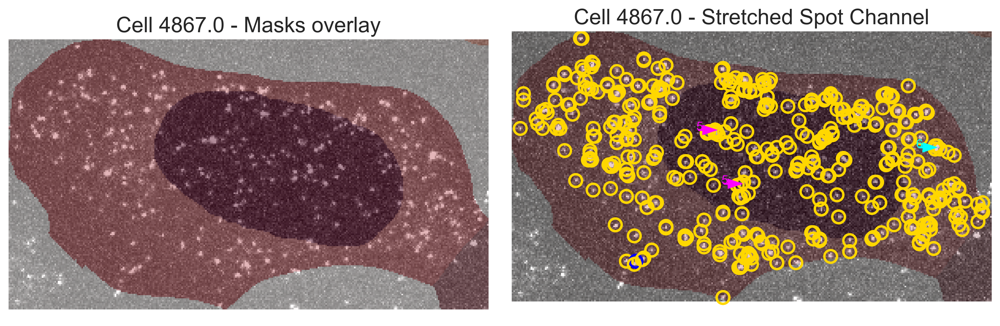

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 4872.


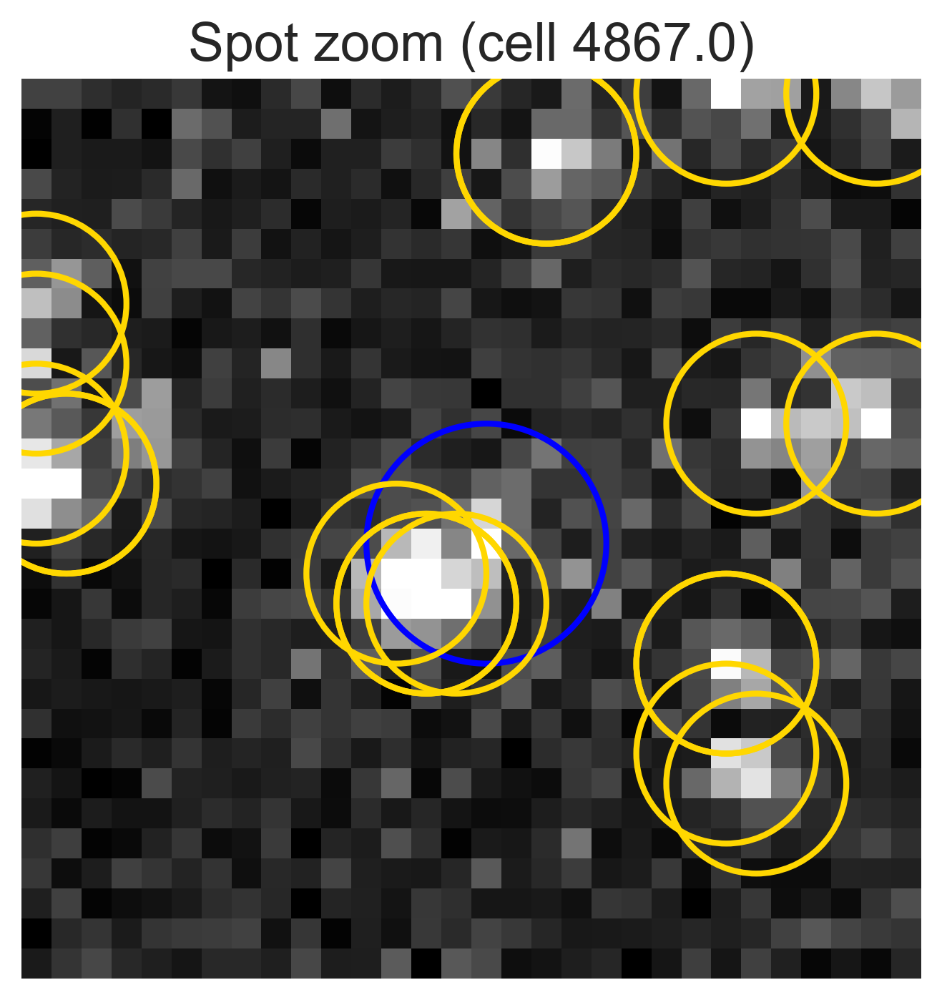


Processing h5_idx 11
  Selected cell with removal 'High' from h5_idx 11.
    Displaying cell plot: NA_40_FOV29_ID5425
Chose unique_cell_id=5429.0 with TS, Foci, and Spot (FOV=29).


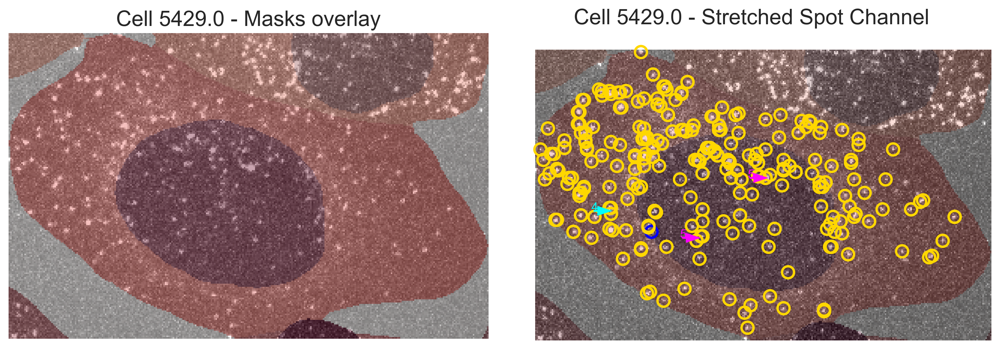

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 5425.


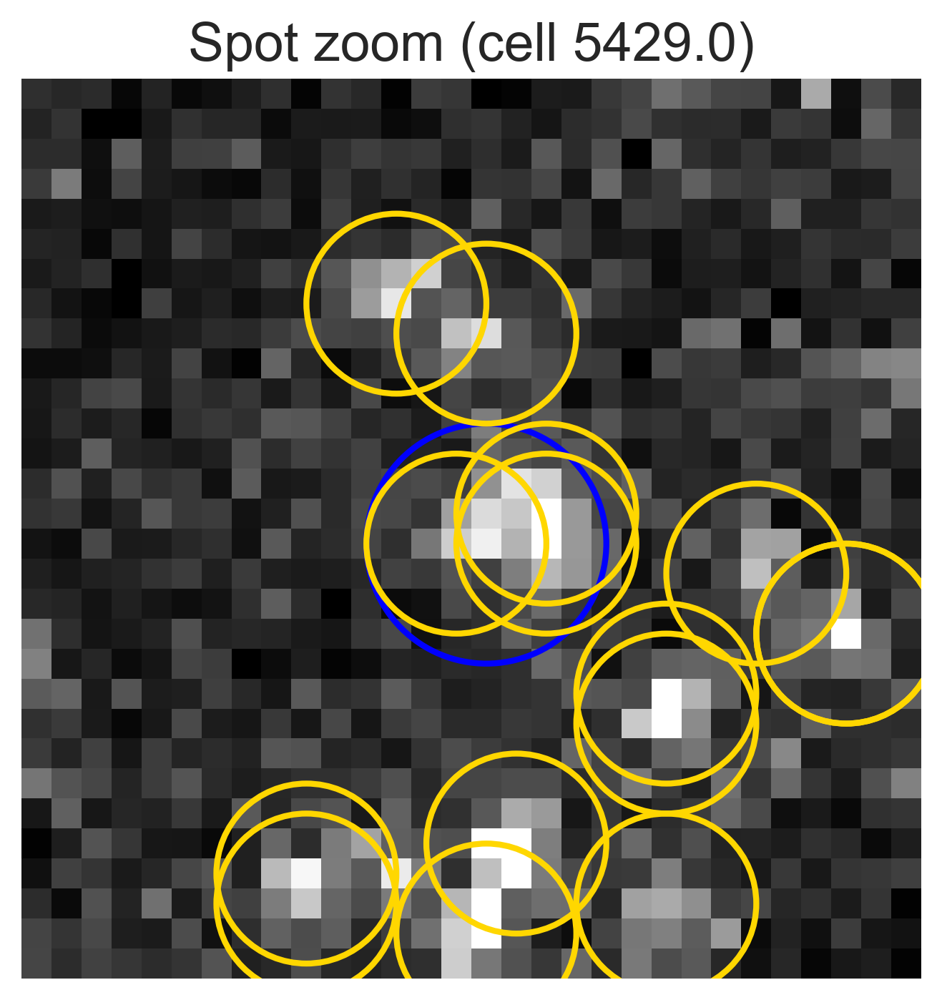

  Selected cell with removal 'Medium' from h5_idx 11.
    Displaying cell plot: NA_40_FOV23_ID5336
Chose unique_cell_id=5334.0 with TS, Foci, and Spot (FOV=23).


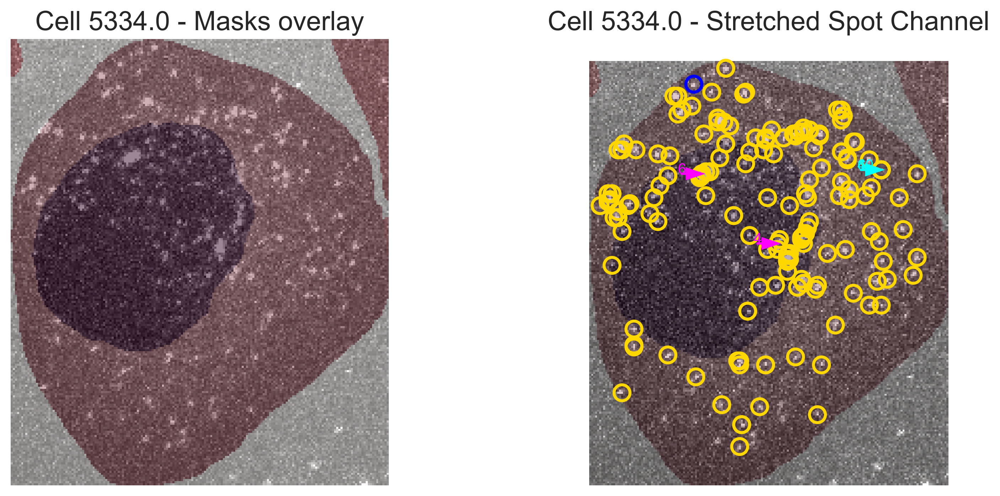

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 5336.


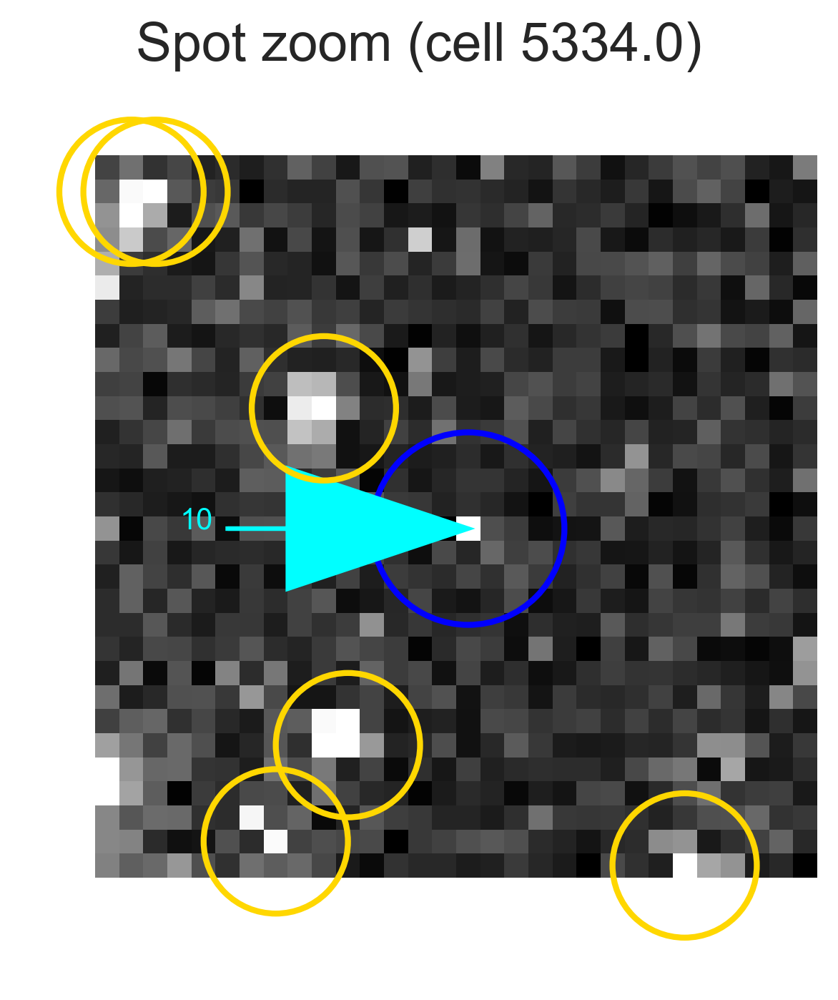

  Selected cell with removal 'Low' from h5_idx 11.
    Displaying cell plot: NA_40_FOV7_ID5091
Chose unique_cell_id=5085.0 with TS, Foci, and Spot (FOV=7).


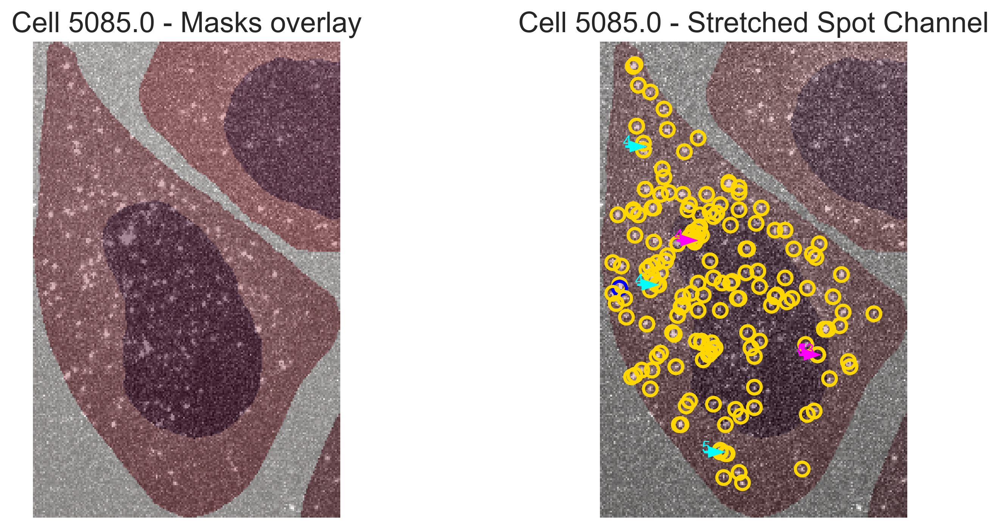

<Figure size 1920x1440 with 0 Axes>

    Displaying spot zoom for cell ID 5091.


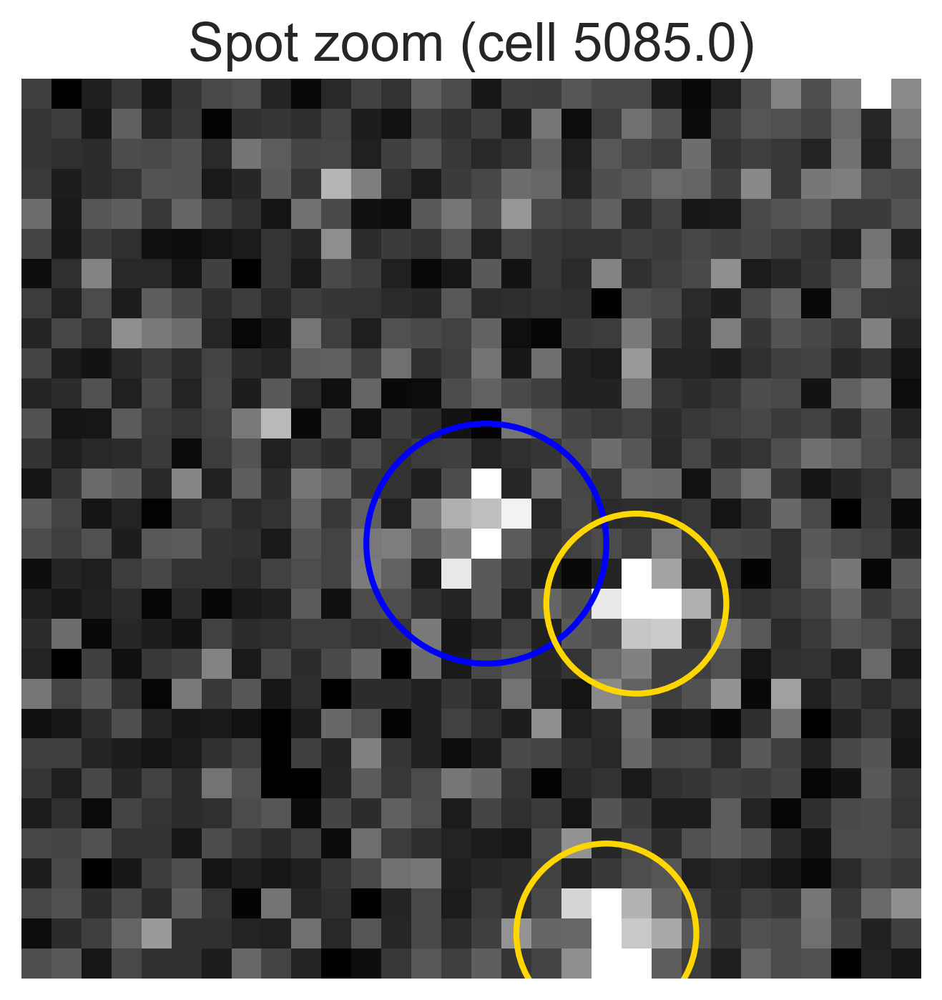

Running display_cell_TS_foci_variations...


In [7]:
# Example usage:
am = DUSP1AnalysisManager(location=loc, log_location=log_location, mac=True)
am.select_analysis('DUSP1_D_Final')

display_manager = DUSP1DisplayManager(am, 
                                      cell_level_results=filtered_cell_level_results,
                                      spots=filtered_spots,
                                      clusters=filtered_clusters,
                                      cellprops=filtered_cellprops,
                                      method='MG',
                                      removed_spots=removed_spots)
# Run the main display function.
display_manager.main_display()